## Installing Libraries and Tools

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

#import gdal
import flir_image_extractor


In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
!apt-get install exiftool


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
Note, selecting 'libimage-exiftool-perl' instead of 'exiftool'
The following additional packages will be installed:
  libarchive-zip-perl libmime-charset-perl libsombok3 libunicode-linebreak-perl
Suggested packages:
  libposix-strptime-perl libencode-hanextra-perl libpod2-base-perl
The following NEW packages will be installed:
  libarchive-zip-perl libimage-exiftool-perl libmime-charset-perl libsombok3
  libunicode-linebreak-perl
0 upgraded, 5 newly installed, 0 to remove and 49 not upgraded.
Need to get 3,964 kB of archives.
After this operation, 23.5 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/main amd64 libarchive-zip-perl all 1.68-1 [90.2 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 libimage-exiftool-perl all 12.40+dfsg-1 [3,717 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/universe amd64 libmime-charset-perl all 1.012.2-1

In [4]:
!which exiftool


/usr/bin/exiftool


In [5]:
path_exif_tool = '/usr/bin/exiftool'

## Kaggle dataset

In [6]:
!pip install kaggle


In [7]:
from google.colab import files

# Upload kaggle.json
uploaded = files.upload()


Saving kaggle.json to kaggle.json


In [8]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json


In [9]:
# Example: Download a Kaggle dataset
!kaggle datasets download -d marcosgabriel/photovoltaic-system-thermography


Dataset URL: https://www.kaggle.com/datasets/marcosgabriel/photovoltaic-system-thermography
License(s): CC0-1.0
 94% 81.0M/86.6M [00:01<00:00, 79.9MB/s]
100% 86.6M/86.6M [00:01<00:00, 78.0MB/s]


In [10]:
!unzip photovoltaic-system-thermography.zip -d ./dataset


Archive:  photovoltaic-system-thermography.zip
  inflating: ./dataset/dataset_1/annotations/001R.json  
  inflating: ./dataset/dataset_1/annotations/002R.json  
  inflating: ./dataset/dataset_1/annotations/003R.json  
  inflating: ./dataset/dataset_1/annotations/004R.json  
  inflating: ./dataset/dataset_1/annotations/005R.json  
  inflating: ./dataset/dataset_1/annotations/006R.json  
  inflating: ./dataset/dataset_1/annotations/007R.json  
  inflating: ./dataset/dataset_1/annotations/008R.json  
  inflating: ./dataset/dataset_1/annotations/009R.json  
  inflating: ./dataset/dataset_1/annotations/010R.json  
  inflating: ./dataset/dataset_1/annotations/011R.json  
  inflating: ./dataset/dataset_1/annotations/012R.json  
  inflating: ./dataset/dataset_1/annotations/013R.json  
  inflating: ./dataset/dataset_1/annotations/014R.json  
  inflating: ./dataset/dataset_1/annotations/015R.json  
  inflating: ./dataset/dataset_1/annotations/016R.json  
  inflating: ./dataset/dataset_1/annotati

In [11]:
fir = flir_image_extractor.FlirImageExtractor(exiftool_path=path_exif_tool)
path_image = '/content/dataset/dataset_1/images/084R.jpg'
os.path.isfile(path_image)

True

In [12]:
fir.process_image(path_image)

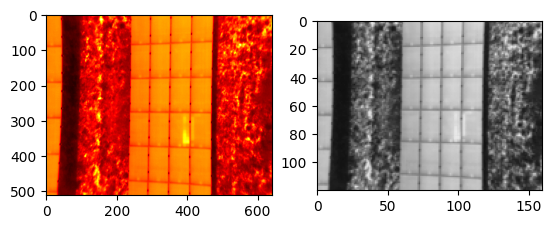

In [13]:
fir.plot()

## Bounding boxes for PV Cells

In [ ]:
pip install git+https://github.com/ultralytics/ultralytics.git


  Cloning https://github.com/ultralytics/ultralytics.git to /tmp/pip-req-build-sq717ed6
  Running command git clone --filter=blob:none --quiet https://github.com/ultralytics/ultralytics.git /tmp/pip-req-build-sq717ed6
  Resolved https://github.com/ultralytics/ultralytics.git to commit ef16c56c99b295a12a302a265e805af1241cd9ca
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for ultralytics: filename=ultralytics-8.3.55-py3-none-any.whl size=904277 sha256=5a70594609dd124d06e5fd287d350cd0d6bfc299190b4dcb0eb8634a7ce7a545
  Stored in directory: /tmp/pip-ephem-wheel-cache-wezljl1r/wheels/45/25/b9/9f1e3857f58c296e7854ef871c3f5a15d519cc6c679848df8e
Successfully built ultralytics


In [ ]:
import cv2
from ultralytics import YOLO
from keras.models import Sequential
from keras.layers import Dense, Conv2D , MaxPool2D , Flatten , Dropout , BatchNormalization
from keras.utils import to_categorical
import numpy as np
import tensorflow as tf
import csv

'''
modelPath = 'C:\\Users\\kashi\\Downloads\\onepvthermal\\best.pt'
inimgpath = "C:\\Users\\kashi\\Downloads\\onepvthermal\\in\\DJI_0010_R.jpg"
outgraypath = 'C:\\Users\\kashi\\Downloads\\onepvthermal\\gray.png'
weight_path = 'C:\\Users\\kashi\\Downloads\\onepvthermal\\comp1.h5'
csvname = "C:\\Users\\kashi\\Downloads\\onepvthermal\\out3.csv"'''

modelPath = "/content/best.pt"
inimgpath = "/content/DJI_0501_R.JPG"
outgraypath = "gray.png"
weight_path = "/content/comp1.h5"
csvname = "out3.csv"

def create_model(model_path):
    model = Sequential()
    model.add(Conv2D(32 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu' , input_shape = (40,24,3)))
    model.add(BatchNormalization())
    model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
    model.add(Conv2D(32 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu'))
    model.add(BatchNormalization())
    model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
    model.add(Conv2D(64 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu'))
    model.add(BatchNormalization())
    model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
    model.add(Conv2D(128 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu'))
    model.add(BatchNormalization())
    model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
    model.add(Conv2D(256 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu'))
    model.add(BatchNormalization())
    model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
    model.add(Conv2D(512 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu'))
    model.add(BatchNormalization())
    model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
    model.add(Flatten())
    model.add(Dense(units = 216 , activation = 'relu'))
    model.add(Dropout(0.5))
    model.add(Dense(units = 128 , activation = 'relu'))
    model.add(Dropout(0.5))
    model.add(Dense(10 , activation = 'softmax'))
    model.compile(loss='categorical_crossentropy',
                  optimizer=tf.keras.optimizers.Nadam(learning_rate=0.001),
                  metrics=['accuracy'])
    model.load_weights(model_path,skip_mismatch=True)
    return model

def predict(model, img):
    #img = cv2.imread(img_path)
    #img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = img[np.newaxis, ...]
    y_pred = model.predict(img)
    y_pred = np.argmax(y_pred,axis =1)
    # Convert predicted class labels to one-hot encoding using to_categorical
    y_pred_cat = to_categorical(y_pred)
    return y_pred_cat

def convertlabel(num):
    label=""
    if num ==0:
        label="Cell"
    elif num==1:
        label="Cell-Multi"
    elif num==2:
        label= "Cracking"
    elif num==3:
        label = "Diode"
    elif num==4:
        label = "Diode-Multi"
    elif num==5:
        label="No-Anomaly"
    elif num==6:
        label ="Offline-Module"
    elif num==7:
        label = "Shadowing"
    elif num==8:
        label= "Soiling"
    elif num==9:
        label ="Vegetation"
    return label

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
import cv2
import os
import pandas as pd
from ultralytics import YOLO
import matplotlib.pyplot as plt

folder_path = "/content/dataset/dataset_1/images"  # Folder containing input images
output_csv_path = "filtered_bounding_boxes.csv"  # Output CSV path


# Get the bounding box coordinates for the thermal images
def inferToCsv(weight_path, folder_path, modelPath, output_csv_path):
    bounding_boxes_data = []  # To store bounding box data for all images

    # Load your custom model weights
    model = create_model(weight_path)

    # Load YOLO model
    model2 = YOLO(modelPath)

    # Process each image in the folder
    for image_name in os.listdir(folder_path):
        if image_name.lower().endswith(('.png', '.jpg', '.jpeg')):
            image_path = os.path.join(folder_path, image_name)
            bounding_boxes = []
            filtered_bounding_boxes = []

            # Convert the input image to grayscale and save
            img = cv2.imread(image_path)
            img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            cv2.imwrite(outgraypath, img_gray)

            # Perform inference
            results = model2([outgraypath])

            # Read the original image for visualization
            img_with_boxes = img.copy()

            # Extract bounding box coordinates
            for result in results:
                boxes = result.boxes
                for box in boxes:
                    # Get bounding box coordinates
                    x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
                    area = (x2 - x1) * (y2 - y1)
                    bounding_boxes.append({"coords": (int(x1), int(y1), int(x2), int(y2)), "area": area})

            # Find the maximum bounding box area
            if bounding_boxes:
                max_area = max(box["area"] for box in bounding_boxes)
                area_threshold = 0.5 * max_area

                # Filter bounding boxes by the area threshold
                for box in bounding_boxes:
                    if box["area"] >= area_threshold:
                        filtered_bounding_boxes.append(box["coords"])
                        # Draw the bounding box on the image
                        x1, y1, x2, y2 = box["coords"]
                        cv2.rectangle(img_with_boxes, (x1, y1), (x2, y2), (0, 255, 0), 2)  # Green box

            # Save the image with filtered bounding boxes
            output_image_path = os.path.join("output_images", f"filtered_{image_name}")
            os.makedirs("output_images", exist_ok=True)
            cv2.imwrite(output_image_path, img_with_boxes)

            # Append data for this image
            bounding_boxes_data.append({
                "image_name": image_name,
                "bounding_boxes": filtered_bounding_boxes
            })

    # Save the bounding boxes data to a CSV file
    df = pd.DataFrame(bounding_boxes_data)
    df.to_csv(output_csv_path, index=False)

    # Save the image with filtered bounding boxes
    out_image_path = "output_with_bounding_boxes.png"
    cv2.imwrite(out_image_path, img_with_boxes)

    print(f"Filtered bounding box coordinates saved to {output_csv_path}")

# Run the function
inferToCsv(weight_path, folder_path, modelPath, output_csv_path)



0: 512x640 34 panels, 1371.9ms
Speed: 6.1ms preprocess, 1371.9ms inference, 42.5ms postprocess per image at shape (1, 3, 512, 640)

0: 512x640 30 panels, 2128.2ms
Speed: 10.4ms preprocess, 2128.2ms inference, 1.3ms postprocess per image at shape (1, 3, 512, 640)

0: 512x640 40 panels, 1892.6ms
Speed: 10.3ms preprocess, 1892.6ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)

0: 512x640 37 panels, 1135.3ms
Speed: 15.6ms preprocess, 1135.3ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)

0: 512x640 40 panels, 890.4ms
Speed: 2.6ms preprocess, 890.4ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)

0: 512x640 24 panels, 1049.0ms
Speed: 2.5ms preprocess, 1049.0ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)

0: 512x640 35 panels, 1645.3ms
Speed: 2.9ms preprocess, 1645.3ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 640)

0: 512x640 40 panels, 1246.9ms
Speed: 2.6ms preprocess, 1246.9ms inference, 2.0m

## Hotspt Detection and Outliers on PV Cells

In [ ]:
import os
import pandas as pd
import numpy as np
from tqdm import tqdm
from ast import literal_eval  # To parse string representation of lists/tuples

# Paths
image_folder = "/content/dataset/dataset_1/images"  # Path to thermal images folder
bounding_boxes_csv = "filtered_bounding_boxes.csv"  # CSV with bounding box coordinates
output_csv = "bounding_box_temperature_statistics.csv"  # Output CSV

# Load bounding box data
bounding_boxes_df = pd.read_csv(bounding_boxes_csv)

# Initialize variables to track global max and min temperatures
global_max_temp = float('-inf')
global_min_temp = float('inf')

# Initialize a list to store all statistics
all_statistics = []

# Get the temperature grid for the thermal image
def process_thermal_image(thermal_image_path):
    """
    Process a thermal image to extract temperature data.
    """
    fir.process_image(thermal_image_path)
    fir.export_thermal_to_csv('temp_thermal_data.csv')  # Temporary file

    # Read the CSV file into a DataFrame
    df = pd.read_csv("temp_thermal_data.csv")

    # Delete the temporary CSV file
    if os.path.exists("temp_thermal_data.csv"):
        os.remove("temp_thermal_data.csv")

    # Convert temperature data into a 2D array to match image dimensions
    temperature_grid = np.zeros((512, 640))
    temperature_grid[df['x'], df['y']] = df['temp (c)']  # Ensure df is properly defined
    return temperature_grid

# Get the mean and standard deviation for each bounding box of an image
def calculate_boxwise_temperature_statistics(temperature_grid, bounding_boxes):
    """
    Calculate statistics (mean, std, pixel count) for each bounding box.
    """
    statistics = []

    for idx, box in enumerate(bounding_boxes):
        # Ensure the box is a tuple with four values
        if not (isinstance(box, (list, tuple)) and len(box) == 4):
            print(f"Invalid bounding box format: {box}")
            continue  # Skip invalid boxes

        # Unpack the bounding box
        x1, y1, x2, y2 = map(int, box)  # Convert to integers if necessary

        # Ensure bounding box coordinates are within grid bounds
        x1, y1, x2, y2 = max(x1, 0), max(y1, 0), min(x2, temperature_grid.shape[1]), min(y2, temperature_grid.shape[0])

        # Extract temperatures within the bounding box
        box_temperatures = temperature_grid[y1:y2, x1:x2].flatten()

        # Filter out zero values (invalid/missing data)
        valid_temperatures = box_temperatures[box_temperatures > 0]

        # Calculate statistics if there are valid temperatures
        if valid_temperatures.size > 0:
            mean_temp = np.mean(valid_temperatures)
            std_temp = np.std(valid_temperatures)
            num_pixels = valid_temperatures.size
        else:
            mean_temp = None
            std_temp = None
            num_pixels = 0

        # Append the statistics for this bounding box
        statistics.append({
            "bounding_box_id": idx + 1,
            "x1": x1,
            "y1": y1,
            "x2": x2,
            "y2": y2,
            "mean_temperature": mean_temp,
            "std_temperature": std_temp,
            "num_pixels": num_pixels,
        })

    return statistics


# Process each image
for _, row in tqdm(bounding_boxes_df.iterrows(), total=len(bounding_boxes_df)):
    image_name = row['image_name']
    bounding_boxes_str = row['bounding_boxes']

    # Convert string representation of bounding boxes to a list of tuples
    bounding_boxes = literal_eval(bounding_boxes_str)  # Convert string to list of tuples

    # Image path
    image_path = os.path.join(image_folder, image_name)
    if not os.path.exists(image_path):
        print(f"Image not found: {image_path}")
        continue

    # Process the thermal image
    temperature_grid = process_thermal_image(image_path)

    # Update global max and min temperatures
    max_temp = np.max(temperature_grid)
    min_temp = np.min(temperature_grid)
    global_max_temp = max(global_max_temp, max_temp)
    global_min_temp = min(global_min_temp, min_temp)

    # Calculate statistics for the bounding boxes
    statistics = calculate_boxwise_temperature_statistics(temperature_grid, bounding_boxes)

    # Add image name to each statistic
    for stat in statistics:
        stat["image_name"] = image_name
        all_statistics.append(stat)

# Save the results to a CSV
output_df = pd.DataFrame(all_statistics)
output_df.to_csv(output_csv, index=False)
print(f"Temperature statistics saved to {output_csv}")
print(f"Global Maximum Temperature: {global_max_temp:.2f} °C")
print(f"Global Minimum Temperature: {global_min_temp:.2f} °C")


100%|██████████| 120/120 [13:55<00:00,  6.96s/it]

Temperature statistics saved to bounding_box_temperature_statistics.csv
Global Maximum Temperature: 74.97 °C
Global Minimum Temperature: 19.74 °C


In [14]:
global_max_temp = 74.97
global_min_temp = 19.74

In [ ]:
import pandas as pd
import numpy as np
import os
from tqdm import tqdm
from PIL import Image
import shutil
import matplotlib.pyplot as plt
import cv2

# Get the temperature grid for the thermal image
def process_thermal_image(thermal_image_path):
    """
    Process a thermal image to extract temperature data.
    """
    fir.process_image(thermal_image_path)
    fir.export_thermal_to_csv('temp_thermal_data.csv')  # Temporary file

    # Read the CSV file into a DataFrame
    df = pd.read_csv("temp_thermal_data.csv")

    # Delete the temporary CSV file
    if os.path.exists("temp_thermal_data.csv"):
        os.remove("temp_thermal_data.csv")

    # Convert temperature data into a 2D array to match image dimensions
    temperature_grid = np.zeros((512, 640))
    temperature_grid[df['x'], df['y']] = df['temp (c)']  # Ensure df is properly defined
    return temperature_grid

# Get the hotspot mask for each image
def create_blended_image_with_hotspots(original_image_path, temperature_grid, bounding_boxes, statistics, output_path):
    """
    Create a blended image highlighting hotspots within each bounding box based on mean and std.

    Parameters:
    - original_image_path: Path to the original thermal image.
    - temperature_grid: 2D numpy array of temperature values.
    - bounding_boxes: List of bounding boxes as tuples (x1, y1, x2, y2).
    - statistics: List of dictionaries containing mean and std for each bounding box.
    - output_path: Path to save the blended image.

    """
    # Load the original thermal image
    original_image = Image.open(original_image_path).convert("RGB")

    # Create overlay arrays
    overlay = np.zeros((512, 640, 3), dtype=np.uint8)
    overlay2 = np.zeros((512,640, 3), dtype=np.uint8)

    # Iterate through each bounding box and its corresponding statistics
    for (x1, y1, x2, y2), stats in zip(bounding_boxes, statistics):
        mean_temp = stats["mean_temperature"]
        std_temp = stats["std_temperature"]

        # Ensure the bounding box is within the bounds of the temperature grid
        x1, y1, x2, y2 = max(x1, 0), max(y1, 0), min(x2, temperature_grid.shape[1]), min(y2, temperature_grid.shape[0])

        # Apply a mask for the hotspots (temperatures above the threshold)
        box_temperatures = temperature_grid[y1:y2, x1:x2]
        if mean_temp is not None and std_temp is not None:
            threshold_temp_min = mean_temp + 1.1 * std_temp

            hotspot_mask = box_temperatures > threshold_temp_min

            # Set overlay color for hotspots (e.g., red)
            overlay[y1:y2, x1:x2][hotspot_mask] = [255, 0, 0]  # Red for hotspots
            overlay2[y1:y2, x1:x2][hotspot_mask] = [255, 255, 255]  # White for hotspots

    # Blend the original image and the overlay
    blended_image = np.array(original_image) * 0.2 + overlay * 0.8  # Adjust blend ratio as needed
    blended_image = blended_image.astype(np.uint8)
    segmented_image = overlay2.astype(np.uint8)

    # Convert blended image to PIL format and save
    segmented_pil_image = Image.fromarray(segmented_image)
    segmented_pil_image.save(output_path)

# Process each image
def process_images_with_statistics(images_folder, csv_file, output_folder):
    """
    Process images and save blended images with hotspots using data from a CSV file.

    Parameters:
    - images_folder: Folder containing the original thermal images.
    - csv_file: Path to the CSV file with bounding box statistics.
    - temperature_grids_folder: Folder containing the temperature grids for each image.
    - output_folder: Folder to save the blended images.

    """
    # Read the CSV file
    statistics_df = pd.read_csv(csv_file)

    # Ensure the output folder exists
    os.makedirs(output_folder, exist_ok=True)

    # Process each image
    # for _, row in tqdm(bounding_boxes_df.iterrows(), total=len(bounding_boxes_df)):
    for image_name in tqdm(statistics_df["image_name"].unique(), total=len(statistics_df["image_name"].unique())):
        # Get the original image path
        original_image_path = os.path.join(images_folder, image_name)

        # Load temperature grid for the image
        temperature_grid = process_thermal_image(original_image_path)

        # Get bounding boxes and statistics for the image
        image_data = statistics_df[statistics_df["image_name"] == image_name]
        # print(image_data)

        bounding_boxes = image_data[["x1", "y1", "x2", "y2"]].values.tolist()
        statistics = image_data.to_dict("records")

        # Define output path for the blended image
        output_path = os.path.join(output_folder, f"{os.path.splitext(image_name)[0]}_blended.jpg")

        # Create blended image with hotspots
        create_blended_image_with_hotspots(original_image_path, temperature_grid, bounding_boxes, statistics, output_path)

        # print(f"Processed and saved: {output_path}")

# Define paths
images_folder = "/content/dataset/dataset_1/images"
csv_file = "/content/bounding_box_temperature_statistics.csv"
output_folder = "/content/blended_images_with_hotspots"

# Run the processing function
process_images_with_statistics(images_folder, csv_file, output_folder)

# Zip the output folder for download
shutil.make_archive(output_folder, 'zip', output_folder)


100%|██████████| 120/120 [13:31<00:00,  6.76s/it]


'/content/blended_images_with_hotspots.zip'

In [15]:
import os
import zipfile

# Path to the zip file
zip_file_path = "/content/blended_images_with_hotspots.zip"  # Adjust the path if the file is elsewhere

# Destination folder
destination_folder = "/content/blended_images_with_hotspots"

# Ensure the destination folder exists
os.makedirs(destination_folder, exist_ok=True)

# Extract the zip file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(destination_folder)

print(f"Archive extracted to {destination_folder}")


Archive extracted to /content/blended_images_with_hotspots


In [ ]:
import pandas as pd
import cv2
import numpy as np
from tqdm import tqdm
from skimage.measure import regionprops, label
import os

# Get the temperature grid for the thermal image
def process_thermal_image(thermal_image_path):
    """
    Process a thermal image to extract temperature data.
    """
    fir.process_image(thermal_image_path)
    fir.export_thermal_to_csv('temp_thermal_data.csv')  # Temporary file

    # Read the CSV file into a DataFrame
    df = pd.read_csv("temp_thermal_data.csv")

    # Delete the temporary CSV file
    if os.path.exists("temp_thermal_data.csv"):
        os.remove("temp_thermal_data.csv")

    # Convert temperature data into a 2D array to match image dimensions
    temperature_grid = np.zeros((512, 640))
    temperature_grid[df['x'], df['y']] = df['temp (c)']  # Ensure df is properly defined
    return temperature_grid

# Edge Features Extraction
def apply_edge_filters(cropped_region):
    """
    Apply Laplacian, Sobel-X, Sobel-Y filters to a cropped region.

    Parameters:
    - cropped_region: Image region to apply filters (grayscale).

    Returns:
    - edge_features: List of edge-related features.
    """
    # Laplacian filter (second-order derivatives)
    laplacian = cv2.Laplacian(cropped_region, cv2.CV_64F)
    laplacian_response = np.mean(np.abs(laplacian))  # Mean response magnitude

    # Sobel filters (first-order derivatives)
    sobel_x = cv2.Sobel(cropped_region, cv2.CV_64F, 1, 0, ksize=3)  # X direction
    sobel_y = cv2.Sobel(cropped_region, cv2.CV_64F, 0, 1, ksize=3)  # Y direction

    sobel_x_response = np.mean(np.abs(sobel_x))  # Mean gradient in X direction
    sobel_y_response = np.mean(np.abs(sobel_y))  # Mean gradient in Y direction

    # Optional: Canny edge detection (returns edges)
    edges = cv2.Canny(cropped_region, threshold1=50, threshold2=150)
    canny_edge_density = np.sum(edges > 0) / cropped_region.size  # Edge pixel density

    # Combine all edge features
    edge_features = [laplacian_response, sobel_x_response, sobel_y_response, canny_edge_density]
    return edge_features

# Extract the feature vector for all images in the dataset
def extract_features_from_dataframe(image_folder, blended_image_folder, statistics_csv_path, output_path):
    """
    Extract features for each bounding box across images and save the results.

    Parameters:
    - image_folder: Path to the folder containing the images.
    - statistics_csv_path: Path to the CSV file containing bounding box statistics.
    - output_path: Path to save the updated DataFrame with features.

    Returns:
    - updated_df: DataFrame with extracted features.
    """
    # Load the bounding box statistics CSV
    statistics_df = pd.read_csv(statistics_csv_path)

    # Initialize lists for storing features and additional details
    features = []
    hotspot_features = []

    # Iterate through unique images in the CSV
    for image_name in tqdm(statistics_df["image_name"].unique(), total=len(statistics_df["image_name"].unique())):
        # Construct the image path
        thermal_image_path = os.path.join(image_folder, image_name)
        # print(thermal_image_path)
        image_path = os.path.join(blended_image_folder, image_name.replace('.jpg', '_blended.jpg'))
        # print(image_path)

        # Load the corresponding thermal image
        # if not os.path.exists(image_path):
        #     print(f"Image {image_name} not found. Skipping.")
        #     continue
        # else :
        #     print(f"Processing image {image_name}")

        # Process the thermal image
        temperature_grid = process_thermal_image(thermal_image_path)  # Replace with your FLIR tool processing
        # print(temperature_grid.shape)
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

        # Filter rows for the current image
        image_df = statistics_df[statistics_df['image_name'] == image_name]
        # print(image_df)

        idx = 0

        # Iterate through bounding boxes
        for index, row in image_df.iterrows():
            # Get bounding box coordinates
            x_min, y_min, x_max, y_max = int(row['x1']), int(row['y1']), int(row['x2']), int(row['y2'])
            mean_cell_temp = row['mean_temperature']
            std_dev = row['std_temperature']

            if std_dev >= 1.5:
                # Crop the bounding box region from the temperature grid
                cropped_temp_grid = temperature_grid[y_min:y_max, x_min:x_max]

                # Threshold to isolate hotspots (binary thresholding)
                cropped = image[y_min:y_max, x_min:x_max]
                _, binary = cv2.threshold(cropped, 127, 255, cv2.THRESH_BINARY)

                # Label connected components in the binary image (hotspots)
                labeled = label(binary)
                props = regionprops(labeled)

                for prop in props:
                    # Extract shape features
                    aspect_ratio = prop.minor_axis_length / prop.major_axis_length if prop.major_axis_length != 0 else 0
                    circularity = (4 * np.pi * prop.area) / (prop.perimeter ** 2) if prop.perimeter != 0 else 0
                    compactness = prop.area / prop.convex_area if prop.convex_area != 0 else 0

                    # Extract hotspot coordinates
                    pixel_bbox = prop.bbox
                    absolute_bbox = np.array(pixel_bbox) + np.array([y_min, x_min, y_min, x_min])   # Add offsets
                    pixel_coords = prop.coords
                    absolute_coords = prop.coords + np.array([y_min, x_min])  # Add offsets

                    # Size and orientation
                    size = prop.area
                    orientation = prop.orientation

                    # Extract the hotspot region temperature from the temperature grid
                    hotspot_pixels = cropped_temp_grid[binary == 255]  # Get hotspot pixels from the grid
                    if len(hotspot_pixels) > 0:
                        mean_hotspot_temp = np.mean(hotspot_pixels)  # Mean temperature of the hotspot region
                    else:
                        mean_hotspot_temp = 0  # If no hotspots, set mean to 0

                    # Calculate temperature sensitivity (hotspot mean - cell mean)
                    temperature_sensitivity = mean_hotspot_temp - mean_cell_temp

                    # Apply edge detection filters
                    edge_features = apply_edge_filters(cropped)

                    # Combine features
                    feature_vector = [
                        aspect_ratio, circularity, compactness, size, orientation,
                        temperature_sensitivity, *edge_features  # Append edge-related features
                    ]
                    hotspot_features.append(feature_vector)

                    # Append the features to the dictionary
                    features.append({
                        "image_name": image_name,
                        "bounding_box_id": index,
                        "absolute_bbox": np.array(prop.bbox) + np.array([y_min, x_min, y_min, x_min]),
                        "absolute_coords": absolute_coords,
                        "AspectRatio": aspect_ratio,
                        "Circularity": circularity,
                        "Compactness": compactness,
                        "Size": size,
                        "Orientation": orientation,
                        "TemperatureSensitivity": temperature_sensitivity,
                        "LaplacianResponse": edge_features[0],
                        "SobelXResponse": edge_features[1],
                        "SobelYResponse": edge_features[2],
                        "CannyEdgeDensity": edge_features[3],
                    })

    # Convert the list of features to a DataFrame
    features_df = pd.DataFrame(features)

    return features_df, hotspot_features

# Define input paths
blended_image_folder = "/content/blended_images_with_hotspots"
image_folder = "/content/dataset/dataset_1/images"
statistics_csv_path = "/content/bounding_box_temperature_statistics.csv"
output_path = "/content/extracted_features.csv"

# Extract features and save the updated DataFrame
features_df, hotspot_features = extract_features_from_dataframe(
    image_folder, blended_image_folder, statistics_csv_path, output_path
)


100%|██████████| 120/120 [13:34<00:00,  6.78s/it]


In [ ]:
features_df

,image_name,bounding_box_id,absolute_bbox,absolute_coords,AspectRatio,Circularity,Compactness,Size,Orientation,TemperatureSensitivity,LaplacianResponse,SobelXResponse,SobelYResponse,CannyEdgeDensity
0,093R.jpg,1,"[104, 227, 106, 228]","[[104, 227], [105, 227]]",0.000000,0.000000,1.000000,2.0,0.000000,2.388342,2.925994,3.213549,3.314433,0.003314
1,093R.jpg,1,"[106, 223, 107, 224]","[[106, 223]]",0.000000,0.000000,1.000000,1.0,-0.785398,2.388342,2.925994,3.213549,3.314433,0.003314
2,093R.jpg,1,"[109, 222, 112, 225]","[[109, 222], [109, 224], [110, 223], [110, 224...",0.971008,3.000801,0.777778,7.0,-0.785398,2.388342,2.925994,3.213549,3.314433,0.003314
3,093R.jpg,4,"[322, 635, 323, 636]","[[322, 635]]",0.000000,0.000000,1.000000,1.0,-0.785398,2.111076,0.756902,0.608754,0.640180,0.001796
4,093R.jpg,15,"[329, 344, 330, 345]","[[329, 344]]",0.000000,0.000000,1.000000,1.0,-0.785398,2.401328,1.693220,2.056610,1.660000,0.002542
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2935,104R.jpg,3004,"[251, 239, 252, 240]","[[251, 239]]",0.000000,0.000000,1.000000,1.0,-0.785398,2.333076,2.130303,2.339057,1.442088,0.004209
2936,104R.jpg,3004,"[253, 239, 255, 240]","[[253, 239], [254, 239]]",0.000000,0.000000,1.000000,2.0,0.000000,2.333076,2.130303,2.339057,1.442088,0.004209
2937,103R.jpg,3031,"[469, 214, 470, 215]","[[469, 214]]",0.000000,0.000000,1.000000,1.0,-0.785398,2.565711,0.491909,0.449376,0.445677,0.001695
2938,103R.jpg,3034,"[161, 306, 166, 312]","[[161, 307], [162, 306], [162, 308], [162, 310...",0.711935,0.947232,0.625000,15.0,1.364400,2.432423,3.416465,3.340367,3.209616,0.004497


## Clustering of hotspots

In [ ]:
# Filter the DataFrame based on the 'Size' column
filtered_features_df = features_df[features_df["Size"] >= 45.0]

# Extract feature vectors for the filtered hotspots
hotspot_features_array = filtered_features_df[
    [
        "AspectRatio",
        "Circularity",
        "Compactness",
        "Size",
        "Orientation",
        "TemperatureSensitivity",
        "LaplacianResponse",
        "SobelXResponse",
        "SobelYResponse",
        "CannyEdgeDensity",
    ]
].values

# Display the filtered DataFrame and the hotspot features array
filtered_features_df.shape

(141, 14)

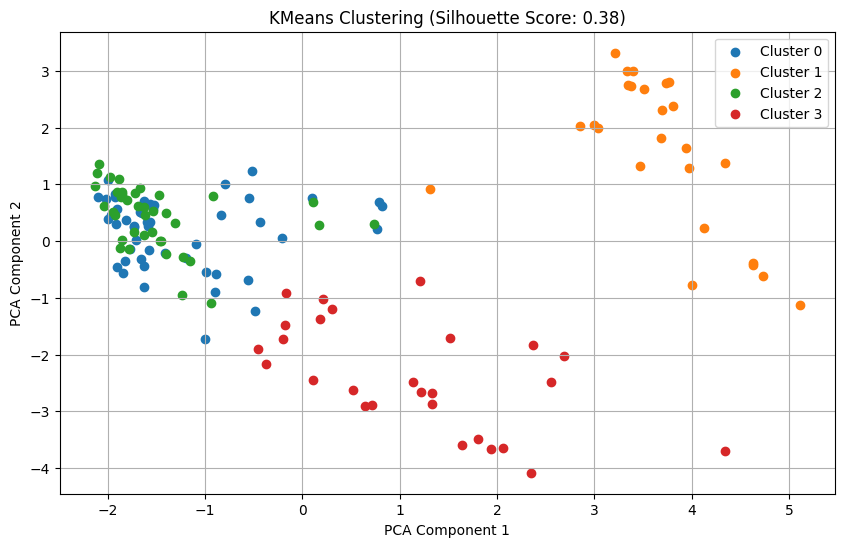

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score

# Standard KMeans Clustering
def mark_and_cluster_hotspots_kmeans(hotspot_features, n_clusters=3):
    """
    Marks the hotspots on the image, clusters them using KMeans, and evaluates the clustering.
    Visualizes the clusters in a 2D scatter plot.

    Parameters:
    - image: Grayscale or binary image with hotspots.
    - hotspot_features: Features extracted from the hotspots.
    - n_clusters: Number of clusters to use in KMeans.

    Returns:
    - clusters: Cluster assignments for each hotspot.
    - silhouette_score_val: Silhouette score of the clustering.
    """
    if len(hotspot_features) > 0:
        hotspot_features = np.array(hotspot_features)
        # # Standardize the features before clustering
        scaler = StandardScaler()
        hotspot_features_scaled = scaler.fit_transform(hotspot_features_array)

        # Perform KMeans clustering
        kmeans = KMeans(n_clusters=n_clusters, random_state=42)
        clusters = kmeans.fit_predict(hotspot_features_scaled)

        # Evaluate clustering performance using silhouette score
        silhouette_score_val = -1
        if len(np.unique(clusters)) > 1:
            try:
                silhouette_score_val = silhouette_score(hotspot_features_scaled, clusters)
            except ValueError:
                pass

        # Reduce dimensions for visualization using PCA
        pca = PCA(n_components=2)
        reduced_features = pca.fit_transform(hotspot_features_scaled)

        # Plot the clusters
        plt.figure(figsize=(10, 6))
        for cluster_id in np.unique(clusters):
            cluster_points = reduced_features[clusters == cluster_id]
            if cluster_id == -1:
                label = "Noise"
                color = "gray"
            else:
                label = f"Cluster {cluster_id}"
                color = None
            plt.scatter(cluster_points[:, 0], cluster_points[:, 1], label=label, cmap="tab20", c=color)

        plt.title(f"KMeans Clustering (Silhouette Score: {silhouette_score_val:.2f})")
        plt.xlabel("PCA Component 1")
        plt.ylabel("PCA Component 2")
        plt.legend()
        plt.grid()
        plt.show()

        return clusters, silhouette_score_val
    else:
        print("No features provided for clustering.")
        return None, -1


# Specify the number of clusters
n_clusters = 4 # Set based on your dataset
clusters, silhouette_score_val = mark_and_cluster_hotspots_kmeans(hotspot_features, n_clusters=n_clusters)


Best Weights: [4.222222222222222, 1.0555555555555556, 0.8333333333333333, 4.666666666666666, 1.5, 0.5, 0.5, 0.6111111111111112, 0.5, 1.2222222222222223]
Best Silhouette Score: 0.755442388418193
Best KMeans model saved to 'kmeans_model.pkl'.


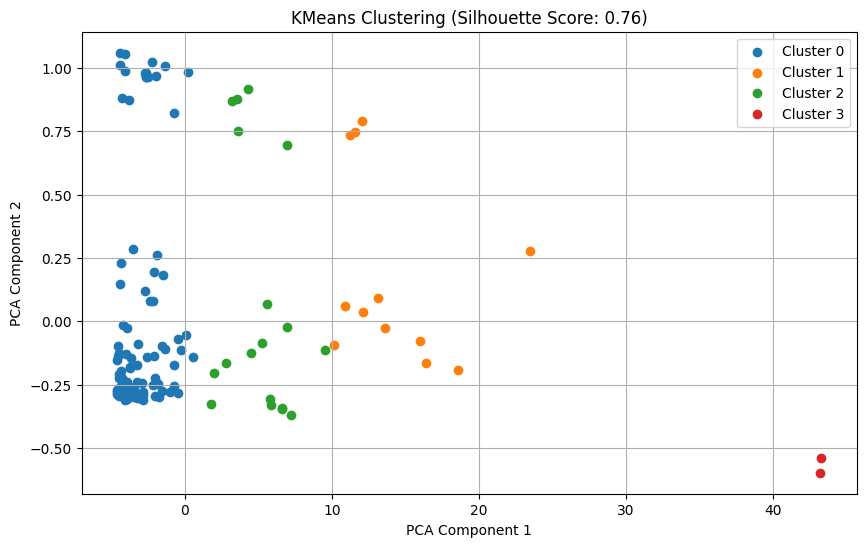

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA
from sklearn.model_selection import ParameterSampler
import joblib

# Modified KMeans Clustering
def mark_and_cluster_hotspots_kmeans(hotspot_features, n_clusters):
    """
    Marks the hotspots on the image, clusters them using KMeans, and evaluates the clustering.

    Parameters:
    - image: Grayscale or binary image with hotspots.
    - hotspot_features: Features extracted from the hotspots.
    - n_clusters: Number of clusters to use in KMeans.

    Returns:
    - clusters: Cluster assignments for each hotspot.
    - silhouette_score_val: Silhouette score of the clustering.
    """

    # Define the range for weights
    param_distributions = {
        "w1": np.linspace(4.0, 5.0, 10),  # Range for the 1st feature
        "w2": np.linspace(0.5, 1.5, 10),  # Range for the 2nd feature
        "w3": np.linspace(0.5, 1.5, 10),  # Range for the 3rd feature
        "w4": np.linspace(2.0, 5.0, 10),  # Emphasize the 4th feature (higher weights)
        "w5": np.linspace(0.5, 1.5, 10),  # Range for the 5th feature
        "w6": np.linspace(0.5, 1.5, 10),  # Range for the 6th feature
        "w7": np.linspace(0.5, 1.5, 10),  # Range for the 7th feature
        "w8": np.linspace(0.5, 1.5, 10),  # Range for the 8th feature
        "w9": np.linspace(0.5, 1.5, 10),  # Range for the 9th feature
        "w10": np.linspace(1.0, 2.0, 10),  # Range for the 10th feature
    }

    # Generate random weight samples
    n_iter = 50  # Number of random weight combinations to test
    random_sampler = ParameterSampler(param_distributions, n_iter=n_iter, random_state=42)

    best_score = -1
    best_weights = None

    if len(hotspot_features) < n_clusters:
        n_clusters = len(hotspot_features)

    if len(hotspot_features) > 0:
        hotspot_features = np.array(hotspot_features)

    for params in random_sampler:
        # Create the weight vector
        weights = [params["w1"], params["w2"], params["w3"], params["w4"],
           params["w5"], params["w6"], params["w7"], params["w8"],
           params["w9"], params["w10"]]

        # Scale the features by the weights
        weighted_features = hotspot_features_array * weights

        # Custom scaling using max_temp and min_temp
        hotspot_features_scaled = (weighted_features - global_min_temp) / (global_max_temp - global_min_temp)

        # Apply K-means clustering
        kmeans = KMeans(n_clusters).fit(hotspot_features_scaled)

        # Evaluate the clustering using silhouette score
        score = silhouette_score(hotspot_features_scaled, kmeans.labels_)

        # Update the best score and weights if the current setup is better
        if score > best_score:
            best_score = score
            best_weights = weights
            best_kmeans = kmeans
            clusters = kmeans.labels_

    # Display the best weights and silhouette score
    print(f"Best Weights: {best_weights}")
    print(f"Best Silhouette Score: {best_score}")

    # Save the best KMeans model
    joblib.dump(best_kmeans, 'kmeans_model.pkl')
    print("Best KMeans model saved to 'kmeans_model.pkl'.")

    # Reduce dimensions for visualization using PCA
    pca = PCA(n_components=2)
    reduced_features = pca.fit_transform(hotspot_features_scaled)

    # Plot the clusters
    plt.figure(figsize=(10, 6))
    for cluster_id in np.unique(clusters):
        cluster_points = reduced_features[clusters == cluster_id]
        if cluster_id == -1:
            label = "Noise"
            color = "gray"
        else:
            label = f"Cluster {cluster_id}"
            color = None
        plt.scatter(cluster_points[:, 0], cluster_points[:, 1], label=label, cmap="tab20", c=color)

    plt.title(f"KMeans Clustering (Silhouette Score: {best_score:.2f})")
    plt.xlabel("PCA Component 1")
    plt.ylabel("PCA Component 2")
    plt.legend()
    plt.grid()
    plt.show()

    return clusters, best_score, best_weights


# # Specify the number of clusters
n_clusters = 4 # Set based on your dataset
clusters, silhouette_score_val, best_weights = mark_and_cluster_hotspots_kmeans(hotspot_features, n_clusters=n_clusters)


In [ ]:
clusters.size

141

In [ ]:
filtered_features_df['Cluster_id'] = clusters

In [ ]:
filtered_features_df

,image_name,bounding_box_id,absolute_bbox,absolute_coords,AspectRatio,Circularity,Compactness,Size,Orientation,TemperatureSensitivity,LaplacianResponse,SobelXResponse,SobelYResponse,CannyEdgeDensity,Cluster_id
21,050R.jpg,36,"[348, 247, 360, 257]","[[348, 249], [348, 250], [348, 251], [348, 252...",0.858837,0.883859,0.885417,85.0,-0.008320,3.562871,6.415345,9.077586,8.040000,0.007414,0
113,002R.jpg,120,"[197, 610, 204, 619]","[[197, 611], [197, 615], [198, 610], [198, 611...",0.729673,0.791575,0.818182,45.0,1.339691,1.991783,4.614717,6.268679,6.825660,0.004151,0
128,035R.jpg,132,"[386, 431, 393, 440]","[[386, 431], [386, 433], [386, 434], [386, 435...",0.748588,1.109615,0.886792,47.0,1.464058,2.582182,3.782222,5.261905,6.135556,0.005079,0
152,035R.jpg,147,"[380, 316, 387, 326]","[[380, 317], [380, 318], [380, 319], [380, 320...",0.737752,0.849921,0.881356,52.0,-1.481602,2.716074,6.130345,7.477241,8.422759,0.009483,0
210,027R.jpg,262,"[316, 26, 327, 39]","[[316, 33], [317, 33], [317, 34], [317, 36], [...",0.767536,0.706741,0.846154,88.0,-1.120000,2.243066,6.640143,8.315412,10.060215,0.007885,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2721,008R.jpg,2672,"[89, 267, 96, 278]","[[89, 268], [89, 269], [89, 271], [89, 272], [...",0.734896,0.648757,0.823529,56.0,-1.415785,2.415873,8.410334,9.908815,12.834347,0.009498,0
2835,080R.jpg,2822,"[19, 281, 36, 294]","[[19, 284], [20, 284], [21, 283], [21, 284], [...",0.739409,0.368332,0.651007,97.0,0.626336,2.200895,16.755879,18.836133,15.343038,0.022770,0
2906,037R.jpg,2957,"[227, 255, 237, 265]","[[227, 258], [227, 260], [228, 256], [228, 257...",0.836327,0.797148,0.833333,75.0,-1.285062,2.533964,6.748538,8.438986,9.508772,0.008187,0
2927,037R.jpg,2970,"[228, 311, 235, 320]","[[228, 312], [228, 313], [228, 314], [228, 315...",0.844979,0.985139,0.903846,47.0,-1.428578,2.860659,3.511148,5.563596,6.591009,0.004203,0


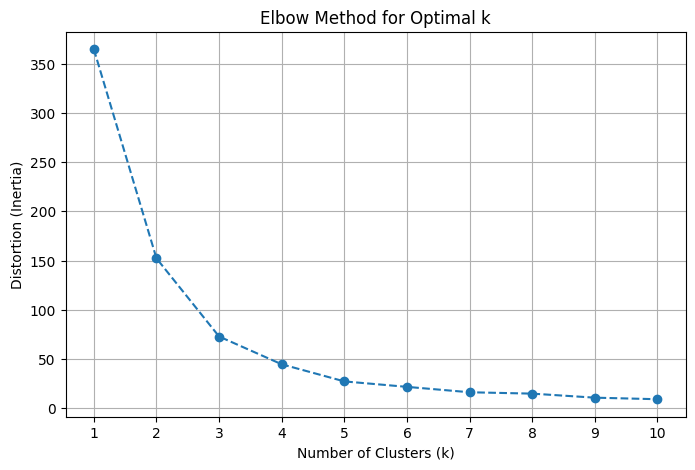

[364.9832019802979,
 152.20901024633625,
 72.67814528698536,
 44.40838742070337,
 26.996667832576957,
 21.44288396893646,
 15.95334763307186,
 14.555582761745992,
 10.446516328267423,
 8.865071909831764]

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

def elbow_method(data, max_clusters=10):
    """
    Perform the Elbow Method to find the optimal number of clusters.

    Parameters:
    - data: Array-like, shape (n_samples, n_features)
      The dataset for clustering.
    - max_clusters: int, default=10
      The maximum number of clusters to test.

    Returns:
    - distortions: List of distortion (inertia) values for each k.
    """
    distortions = []

    for k in range(1, max_clusters + 1):
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(data)
        distortions.append(kmeans.inertia_)  # Inertia = Sum of squared distances to nearest cluster center

    # Plot the Elbow Curve
    plt.figure(figsize=(8, 5))
    plt.plot(range(1, max_clusters + 1), distortions, marker='o', linestyle='--')
    plt.title('Elbow Method for Optimal k')
    plt.xlabel('Number of Clusters (k)')
    plt.ylabel('Distortion (Inertia)')
    plt.xticks(range(1, max_clusters + 1))
    plt.grid()
    plt.show()

    return distortions

# Convert hotspot_features to a NumPy array
hotspot_features = np.array(hotspot_features)

# Custom scaling using max_temp and min_temp
hotspot_features_scaled = (hotspot_features_array - global_min_temp) / (global_max_temp - global_min_temp)


# Apply the Elbow Method
elbow_method(hotspot_features_scaled, max_clusters=10)


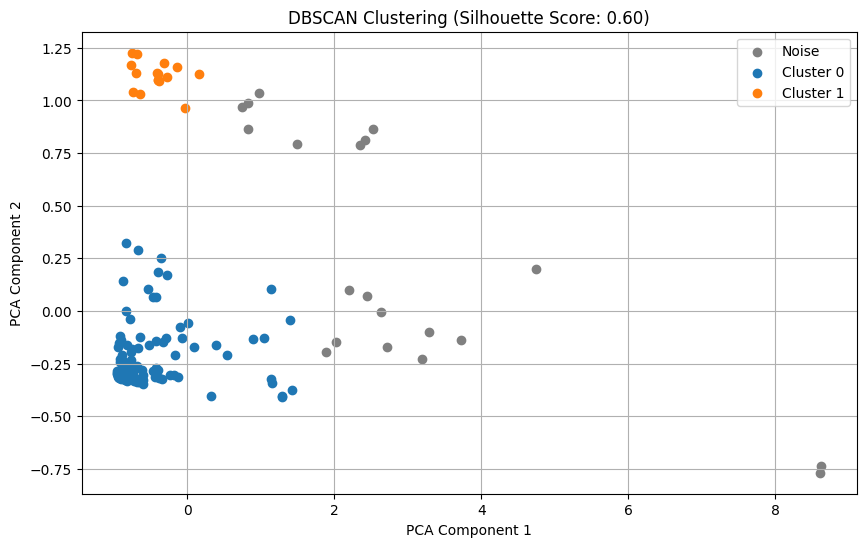

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score

def mark_and_cluster_hotspots_dbscan(image, hotspot_features, eps=0.5, min_samples=5):
    """
    Marks the hotspots on the image, clusters them using DBSCAN, and evaluates the clustering.
    Visualizes the clusters in a 2D scatter plot.

    Parameters:
    - image: Grayscale or binary image with hotspots.
    - hotspot_features: Features extracted from the hotspots.
    - eps: Maximum distance between two points to be considered as neighbors for DBSCAN.
    - min_samples: Minimum number of points to form a cluster.

    Returns:
    - clusters: Cluster assignments for each hotspot.
    - silhouette_score_val: Silhouette score of the clustering (excluding noise points).
    """
    if len(hotspot_features) > 0:
        hotspot_features = np.array(hotspot_features)
        # # Standardize the features before clustering

        # Custom scaling using max_temp and min_temp
        hotspot_features_scaled = (hotspot_features_array - global_min_temp) / (global_max_temp - global_min_temp)

        # Perform DBSCAN clustering
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        clusters = dbscan.fit_predict(hotspot_features_scaled)

        # Evaluate clustering performance using silhouette score (ignoring noise points)
        silhouette_score_val = -1
        if len(np.unique(clusters)) > 1 and len(clusters[clusters != -1]) > 0:
            try:
                silhouette_score_val = silhouette_score(hotspot_features_scaled[clusters != -1], clusters[clusters != -1])
            except ValueError:
                pass

        # Reduce dimensions for visualization using PCA
        pca = PCA(n_components=2)
        reduced_features = pca.fit_transform(hotspot_features_scaled)

        # Plot the clusters
        plt.figure(figsize=(10, 6))
        for cluster_id in np.unique(clusters):
            cluster_points = reduced_features[clusters == cluster_id]
            if cluster_id == -1:
                label = "Noise"
                color = "gray"
            else:
                label = f"Cluster {cluster_id}"
                color = None
            plt.scatter(cluster_points[:, 0], cluster_points[:, 1], label=label, cmap="tab20", c=color)

        plt.title(f"DBSCAN Clustering (Silhouette Score: {silhouette_score_val:.2f})")
        plt.xlabel("PCA Component 1")
        plt.ylabel("PCA Component 2")
        plt.legend()
        plt.grid()
        plt.show()

        return clusters, silhouette_score_val
    else:
        print("No features provided for clustering.")
        return None, -1

# Example Usage
# Load the image
image_path = "/content/blended_image_with_hotspots.jpg"  # Replace with your image file
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Define DBSCAN parameters
eps = 0.5  # Maximum distance for neighboring points
min_samples = 5  # Minimum number of points in a cluster

clusters, silhouette_score_val = mark_and_cluster_hotspots_dbscan(image, hotspot_features, eps=eps, min_samples=min_samples)


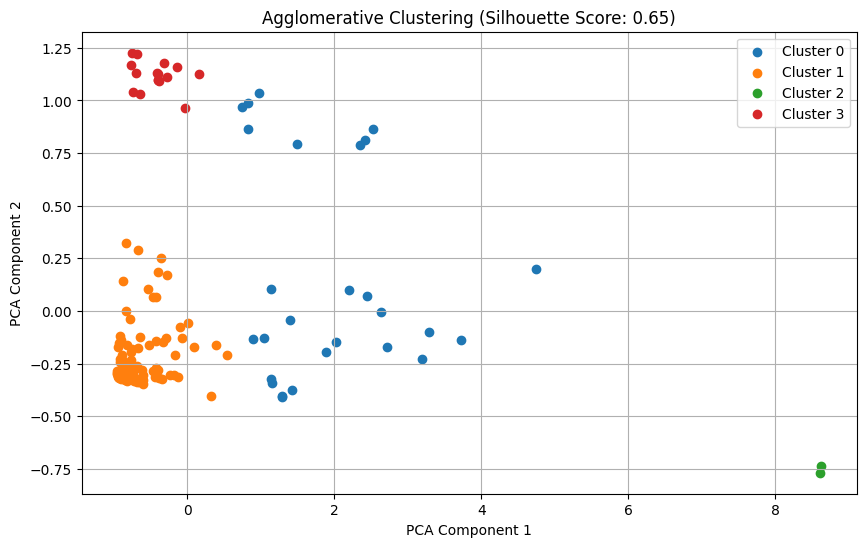

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import AgglomerativeClustering
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score

def mark_and_cluster_hotspots_agglo(image, hotspot_features, n_clusters=4):
    """
    Marks the hotspots on the image, clusters them using Agglomerative Clustering, and evaluates the clustering.
    Visualizes the clusters in a 2D scatter plot.

    Parameters:
    - image: Grayscale or binary image with hotspots.
    - hotspot_features: Features extracted from the hotspots.
    - n_clusters: Number of clusters to form.

    Returns:
    - clusters: Cluster assignments for each hotspot.
    - silhouette_score_val: Silhouette score of the clustering.
    """
    if len(hotspot_features) > 0:
        hotspot_features = np.array(hotspot_features)
        # # Standardize the features before clustering
        # scaler = StandardScaler()
        # hotspot_features_scaled = scaler.fit_transform(hotspot_features)

        # Custom scaling using max_temp and min_temp
        hotspot_features_scaled = (hotspot_features_array - global_min_temp) / (global_max_temp - global_min_temp)

        # Perform Agglomerative Clustering
        agglo_clustering = AgglomerativeClustering(n_clusters=n_clusters)
        clusters = agglo_clustering.fit_predict(hotspot_features_scaled)

        # Evaluate clustering performance using silhouette score
        silhouette_score_val = -1
        if len(np.unique(clusters)) > 1:
            try:
                silhouette_score_val = silhouette_score(hotspot_features_scaled, clusters)
            except ValueError:
                pass

        # Reduce dimensions for visualization using PCA
        pca = PCA(n_components=2)
        reduced_features = pca.fit_transform(hotspot_features_scaled)

        # Plot the clusters
        plt.figure(figsize=(10, 6))
        for cluster_id in np.unique(clusters):
            cluster_points = reduced_features[clusters == cluster_id]
            plt.scatter(cluster_points[:, 0], cluster_points[:, 1], label=f"Cluster {cluster_id}", cmap="tab20")

        plt.title(f"Agglomerative Clustering (Silhouette Score: {silhouette_score_val:.2f})")
        plt.xlabel("PCA Component 1")
        plt.ylabel("PCA Component 2")
        plt.legend()
        plt.grid()
        plt.show()

        return clusters, silhouette_score_val
    else:
        print("No features provided for clustering.")
        return None, -1

# Example Usage
# Load the image
image_path = "/content/blended_image_with_hotspots.jpg"  # Replace with your image file
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Define Agglomerative Clustering parameters
n_clusters = 4  # Specify the desired number of clusters

clusters, silhouette_score_val = mark_and_cluster_hotspots_agglo(image, hotspot_features, n_clusters=n_clusters)


## Getting the clustered images

In [ ]:
filtered_features_df

,image_name,bounding_box_id,absolute_bbox,absolute_coords,AspectRatio,Circularity,Compactness,Size,Orientation,TemperatureSensitivity,LaplacianResponse,SobelXResponse,SobelYResponse,CannyEdgeDensity,Cluster_id
15,050R.jpg,30,"[253, 251, 260, 258]","[[253, 252], [253, 253], [253, 254], [253, 256...",0.856633,0.807637,0.842105,32.0,-0.932128,2.663501,3.809278,5.165304,5.146107,0.003733,1
21,050R.jpg,36,"[348, 247, 360, 257]","[[348, 249], [348, 250], [348, 251], [348, 252...",0.858837,0.883859,0.885417,85.0,-0.008320,3.562871,6.415345,9.077586,8.040000,0.007414,1
39,050R.jpg,50,"[353, 363, 360, 372]","[[353, 365], [354, 364], [354, 365], [354, 366...",0.703458,0.858115,0.809524,34.0,1.557817,2.835853,3.225725,3.976671,5.322509,0.004098,1
71,005R.jpg,86,"[128, 283, 136, 291]","[[128, 283], [129, 284], [130, 284], [130, 285...",0.680245,0.886665,0.787234,37.0,1.103086,2.519028,3.550877,5.293444,5.979317,0.004617,1
76,005R.jpg,92,"[130, 340, 137, 347]","[[130, 342], [130, 343], [130, 344], [131, 340...",0.918723,1.287140,0.875000,35.0,-0.190871,2.576147,3.700098,5.958944,4.737048,0.004301,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2910,037R.jpg,2960,"[427, 423, 433, 431]","[[427, 424], [427, 425], [427, 426], [427, 427...",0.803775,1.110692,0.921053,35.0,1.391644,2.633220,3.060228,4.629722,5.621169,0.003742,1
2912,037R.jpg,2963,"[413, 225, 425, 228]","[[413, 225], [413, 226], [413, 227], [414, 225...",0.239806,0.680965,1.000000,35.0,-0.015085,3.460957,7.172762,9.896552,8.214559,0.008708,1
2921,037R.jpg,2966,"[133, 311, 139, 319]","[[133, 313], [133, 315], [133, 316], [133, 317...",0.840781,0.962312,0.894737,34.0,-1.235619,2.594657,3.848675,5.351988,6.438513,0.005339,1
2927,037R.jpg,2970,"[228, 311, 235, 320]","[[228, 312], [228, 313], [228, 314], [228, 315...",0.844979,0.985139,0.903846,47.0,-1.428578,2.860659,3.511148,5.563596,6.591009,0.004203,1


In [ ]:
# Convert the DataFrame to a CSV file
features_df.to_csv('features & clusters.csv', index=False)

Processing image 050R.jpg


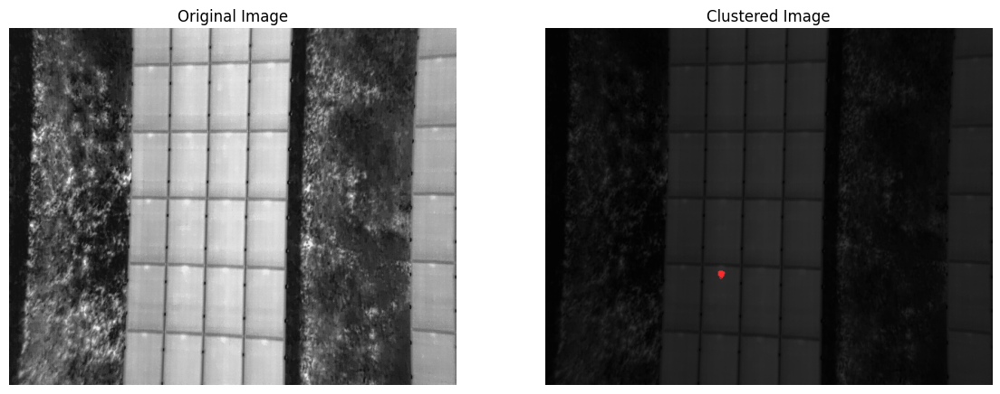

Processing image 002R.jpg


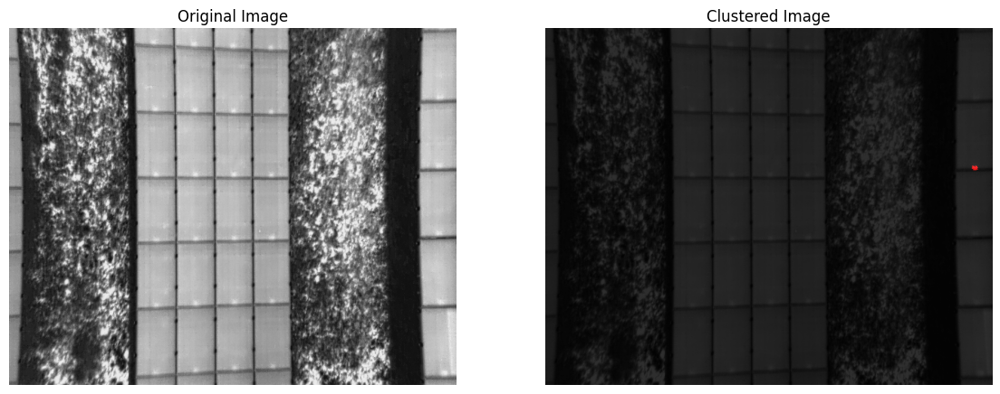

Processing image 035R.jpg


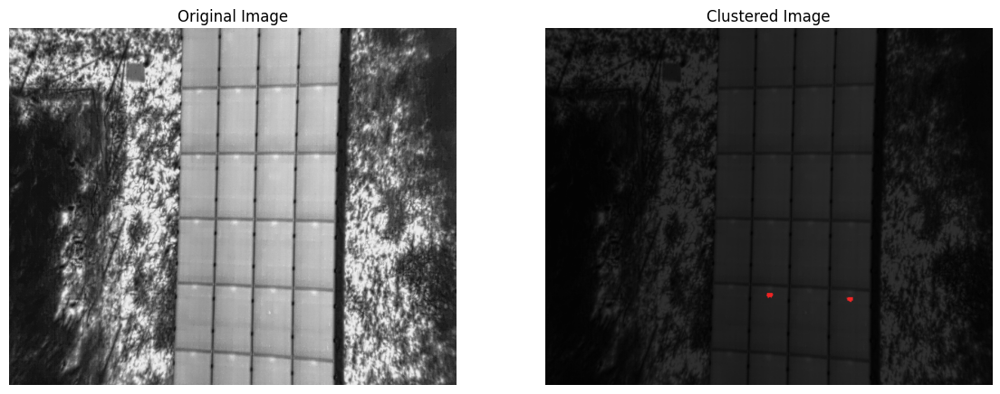

Processing image 027R.jpg


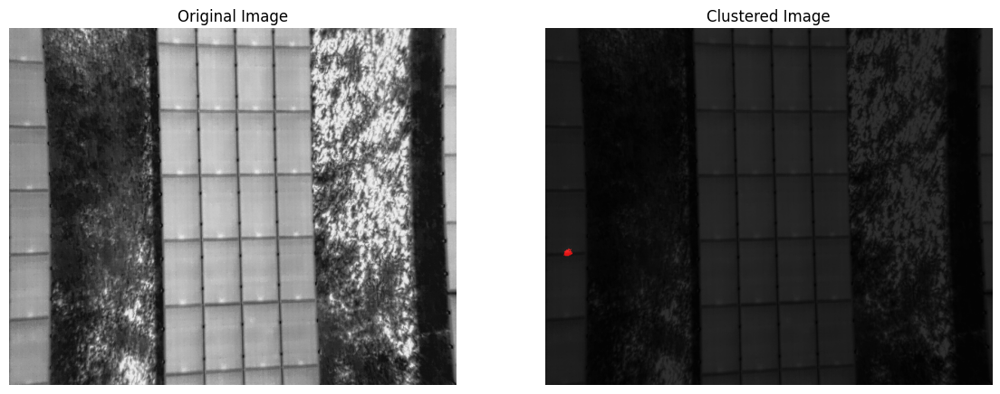

Processing image 059R.jpg


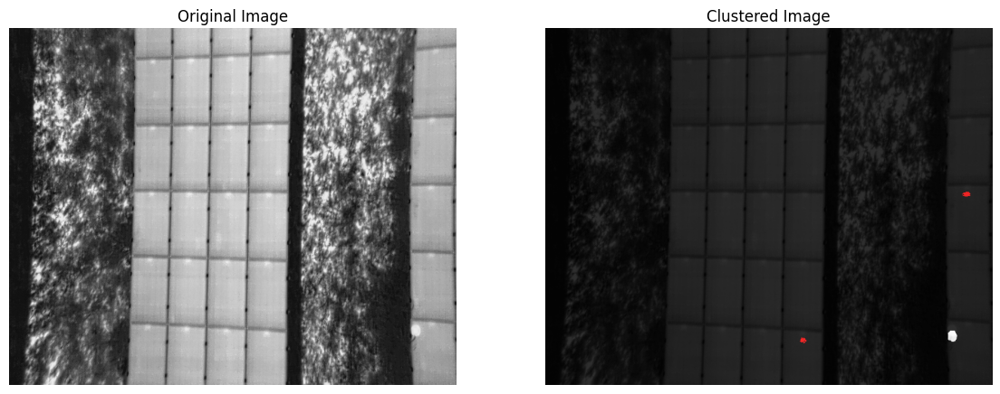

Processing image 043R.jpg


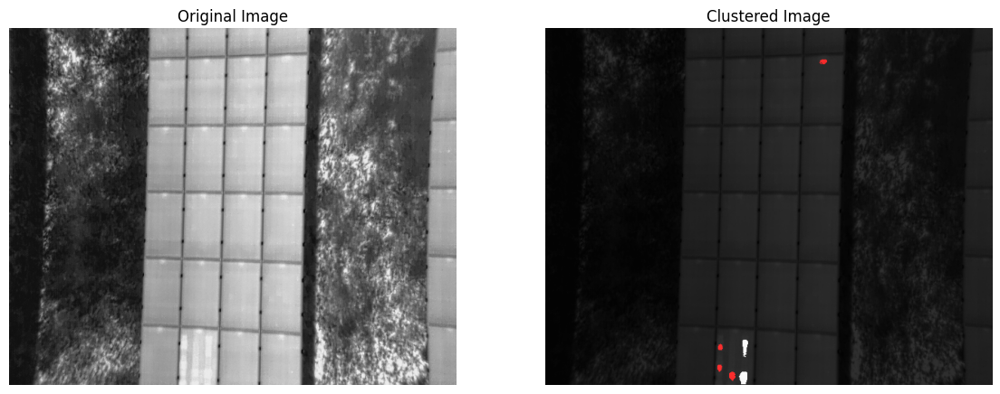

Processing image 018R.jpg


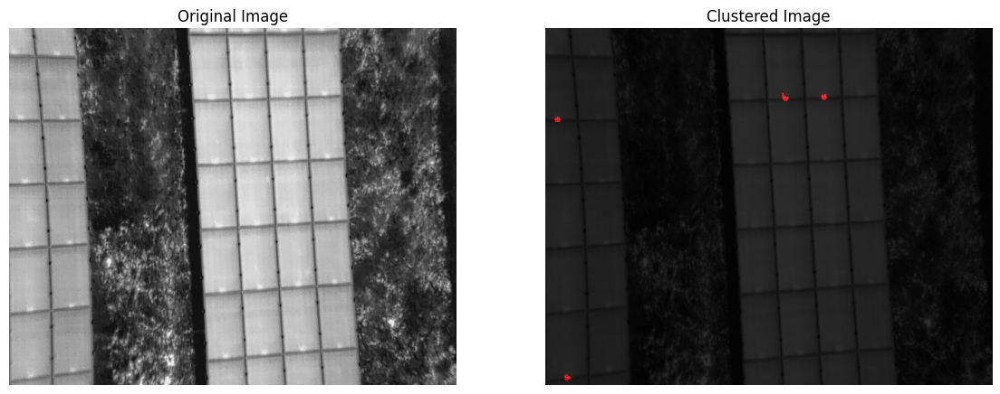

Processing image 084R.jpg


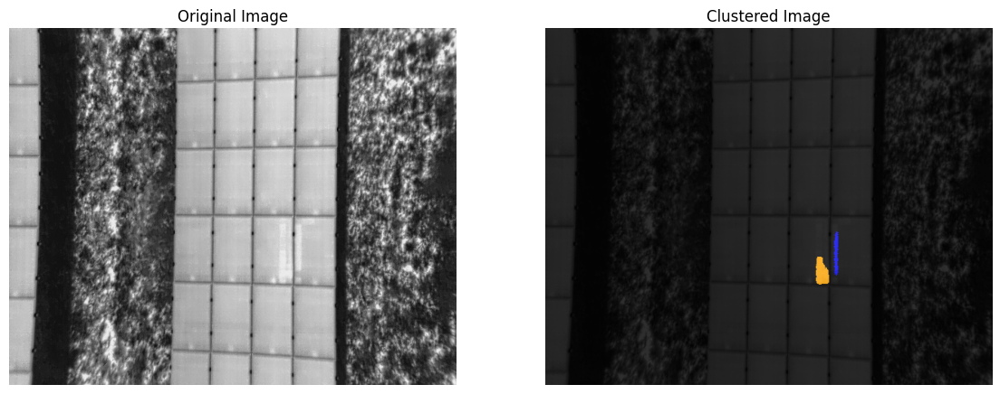

Processing image 028R.jpg


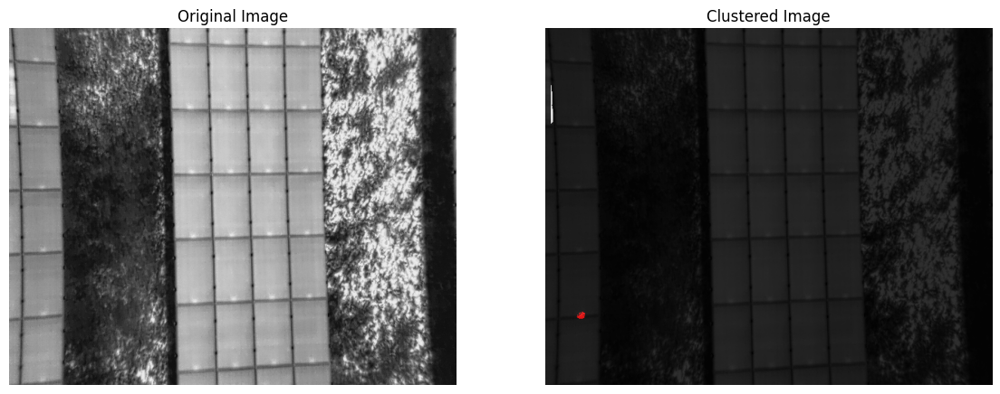

Processing image 046R.jpg


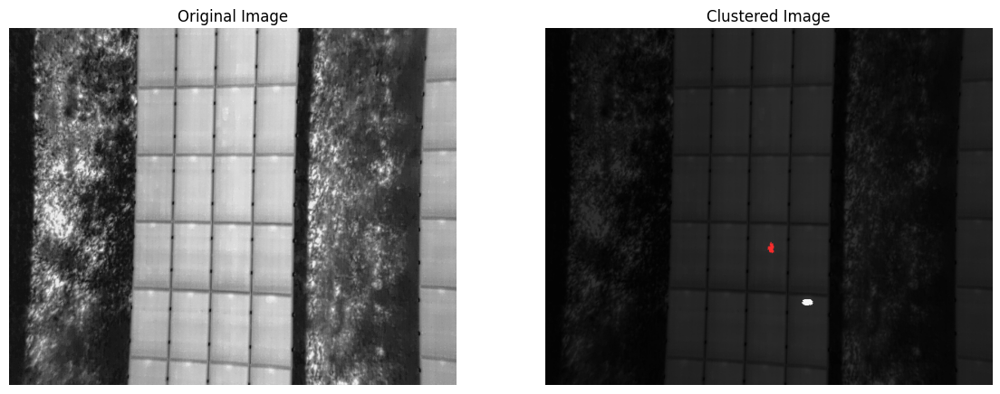

Processing image 083R.jpg


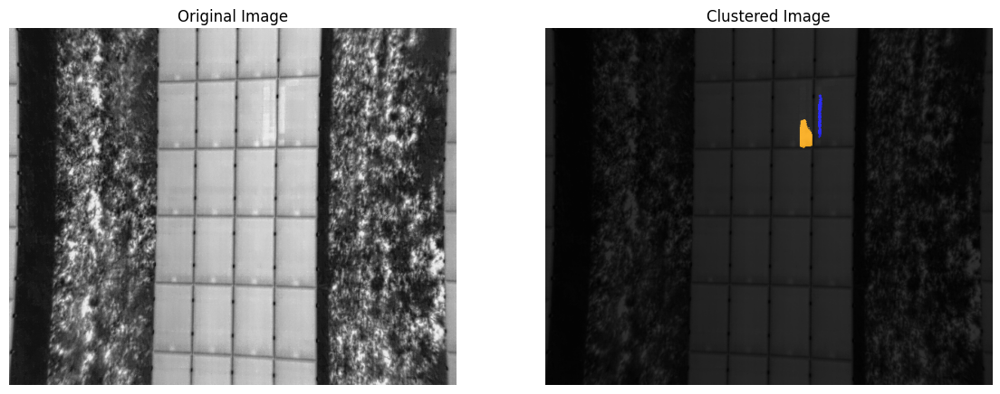

Processing image 009R.jpg


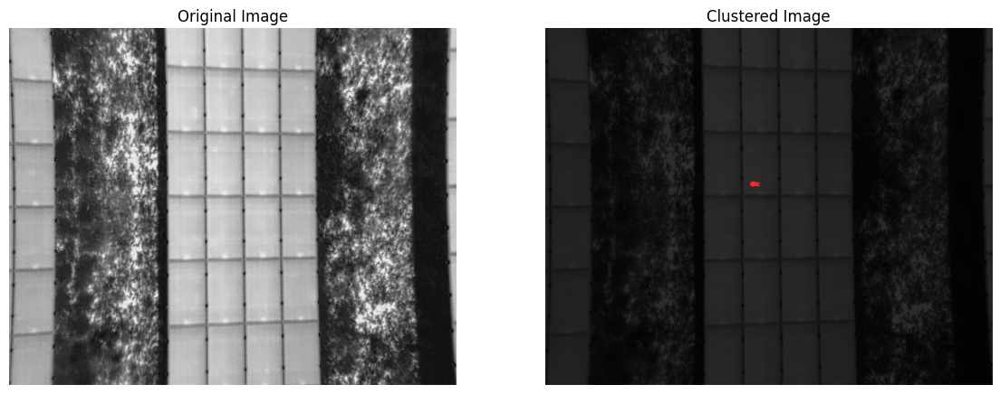

Processing image 033R.jpg


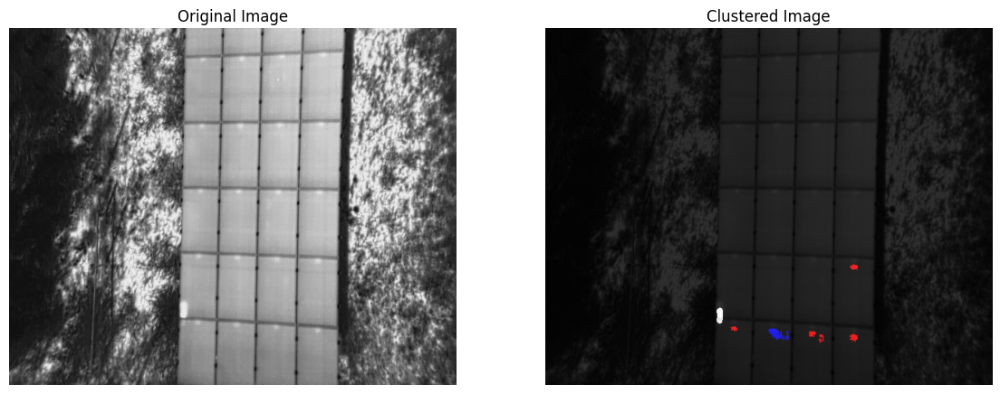

Processing image 054R.jpg


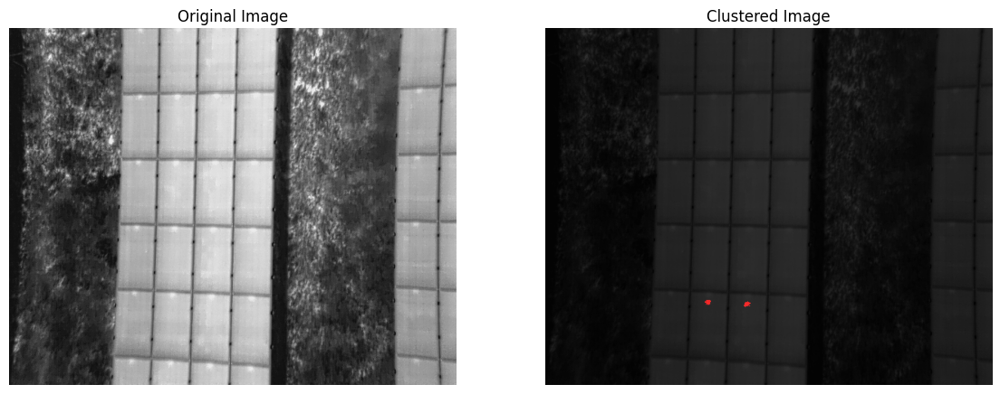

Processing image 063R.jpg


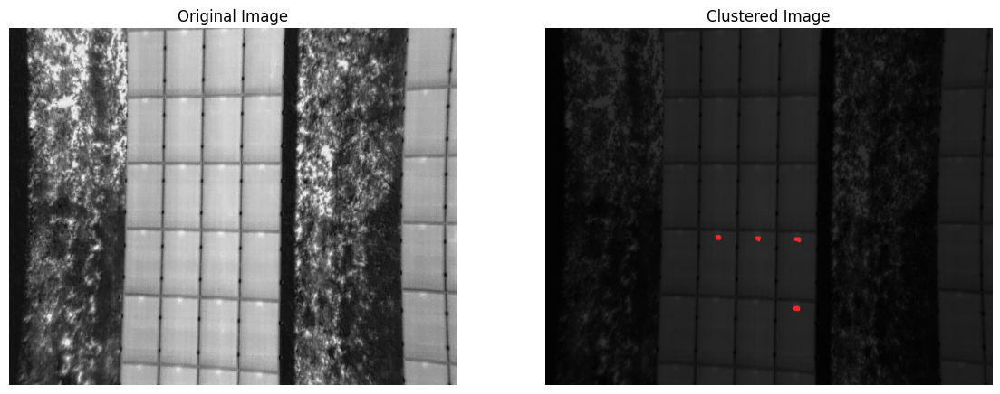

Processing image 040R.jpg


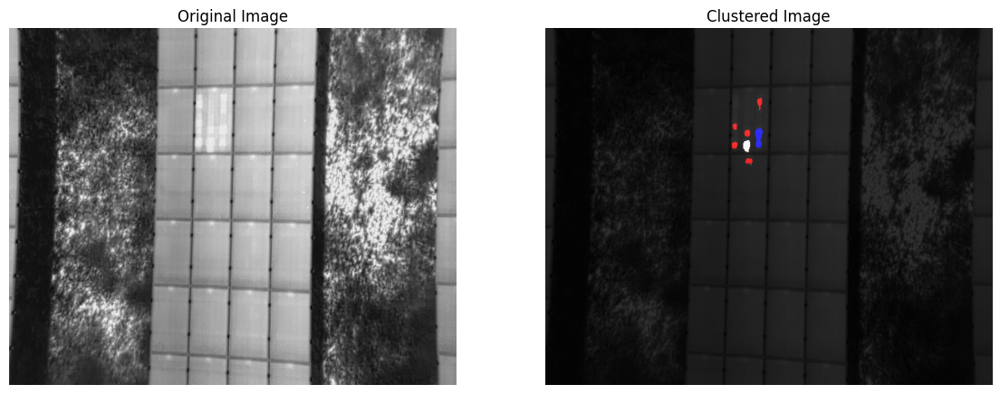

Processing image 065R.jpg


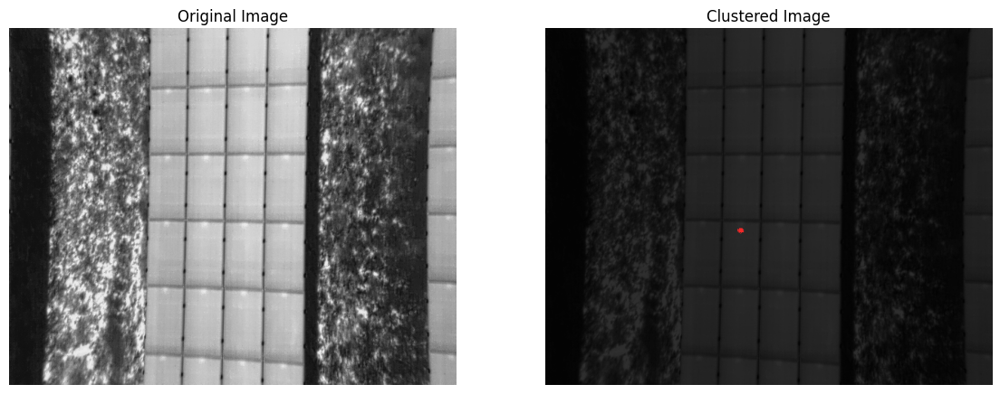

Processing image 057R.jpg


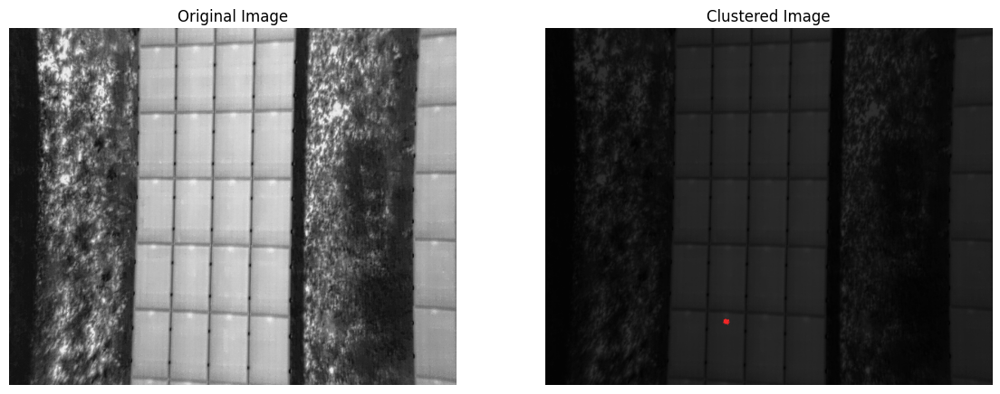

Processing image 011R.jpg


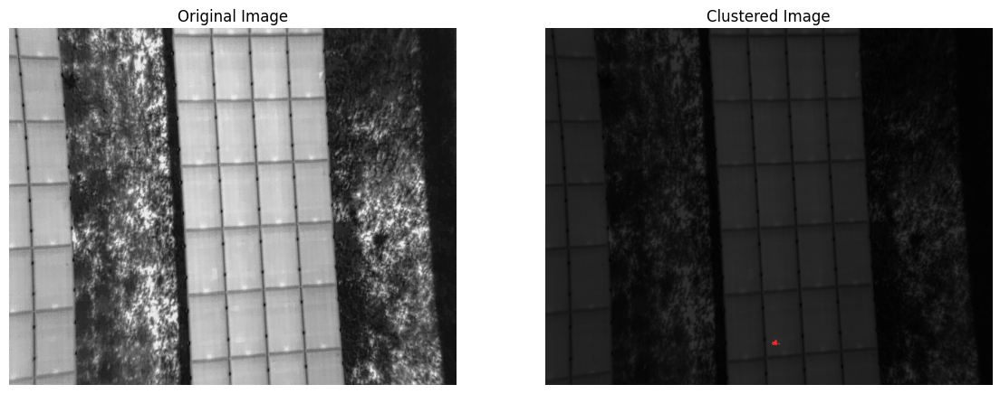

Processing image 055R.jpg


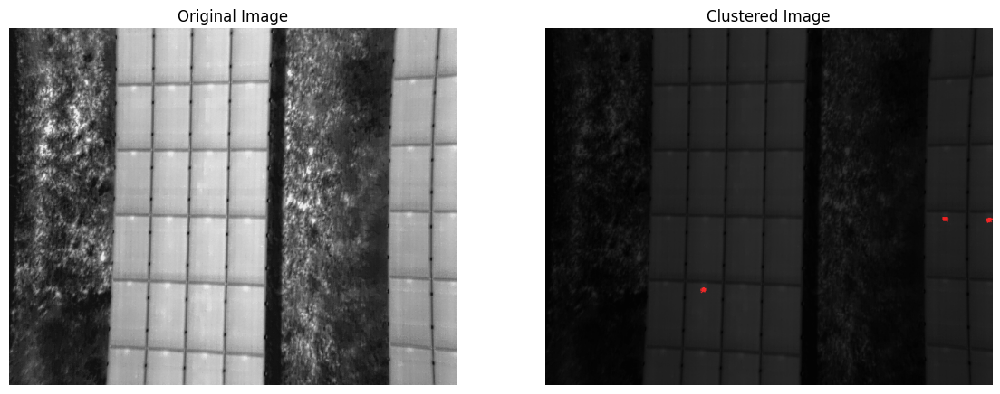

Processing image 019R.jpg


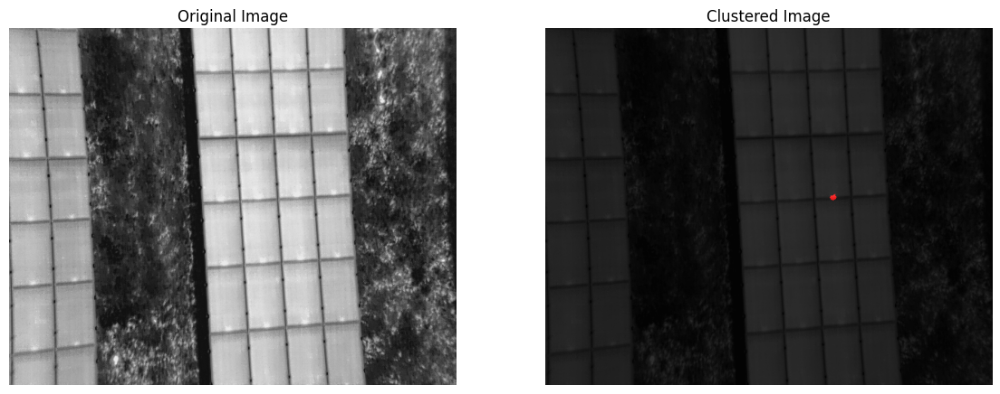

Processing image 066R.jpg


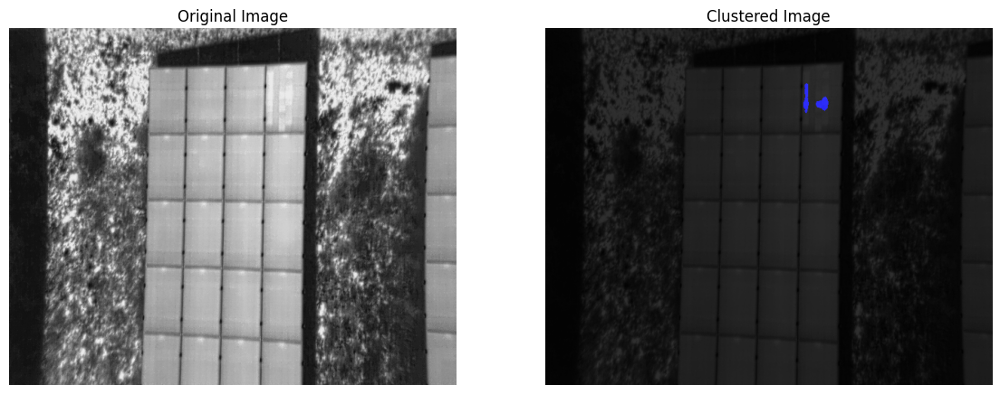

Processing image 031R.jpg


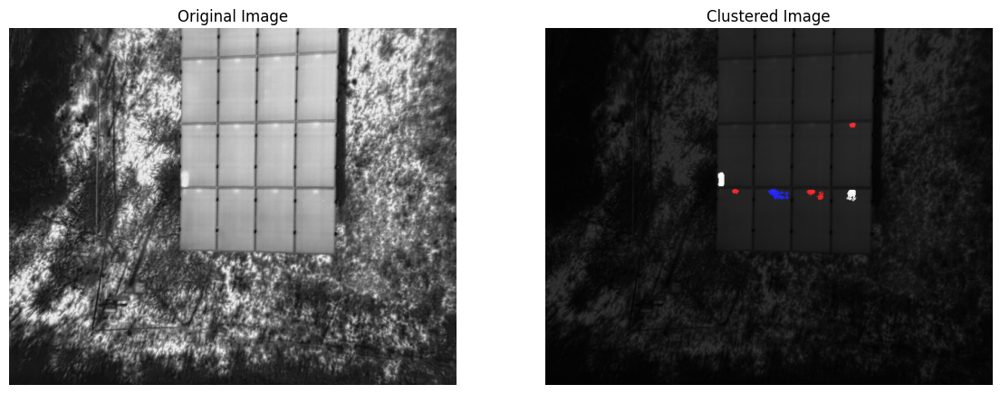

Processing image 038R.jpg


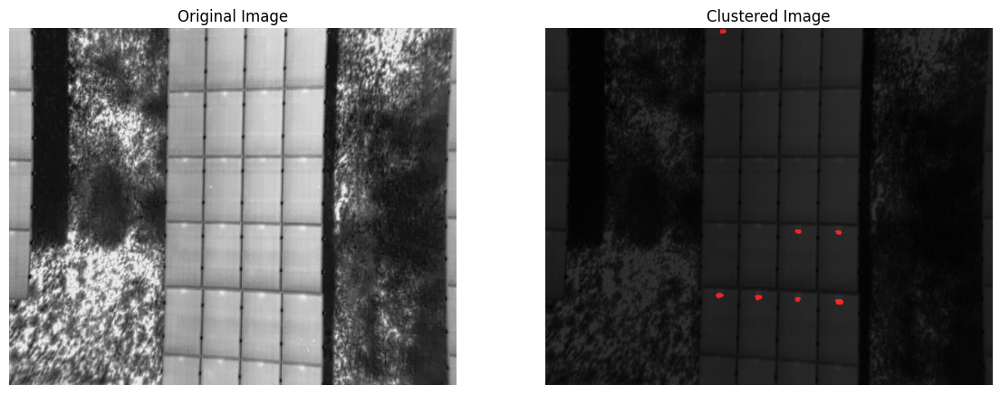

Processing image 085R.jpg


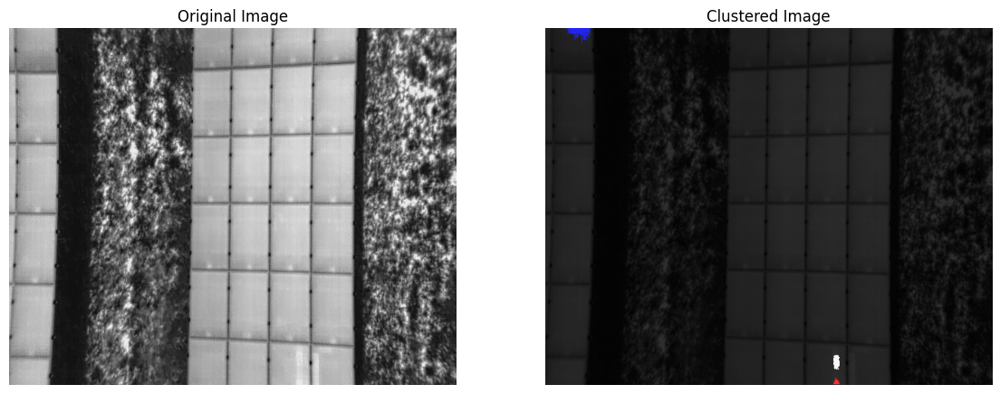

Processing image 032R.jpg


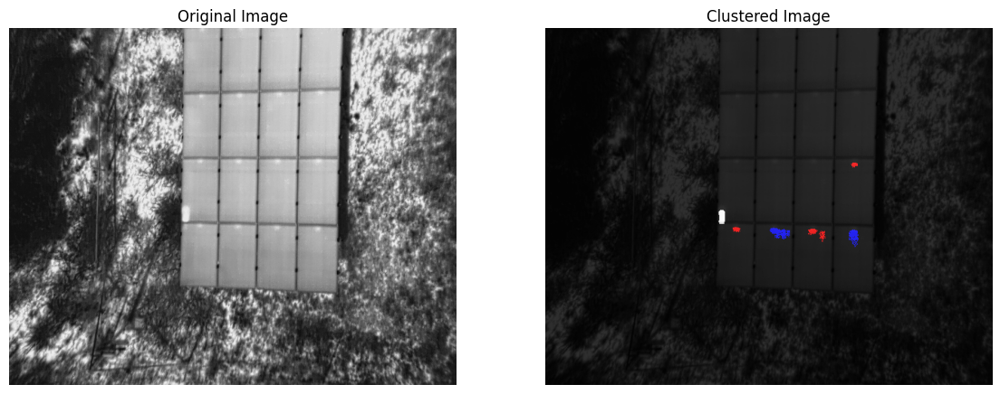

Processing image 056R.jpg


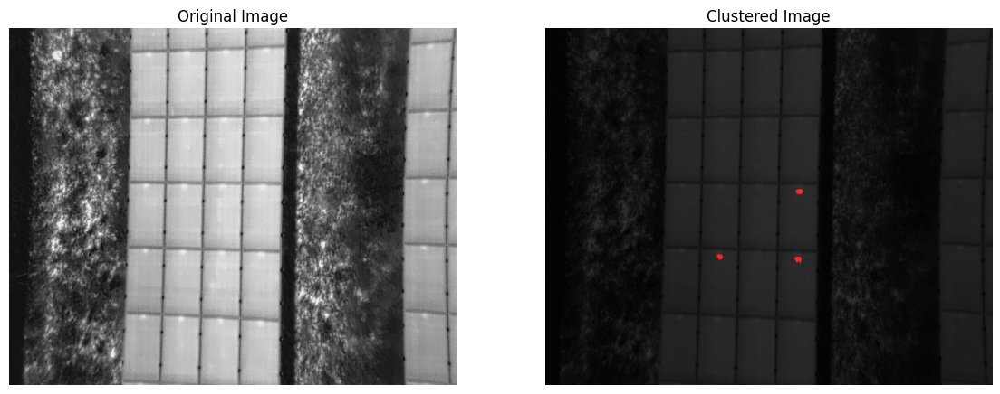

Processing image 058R.jpg


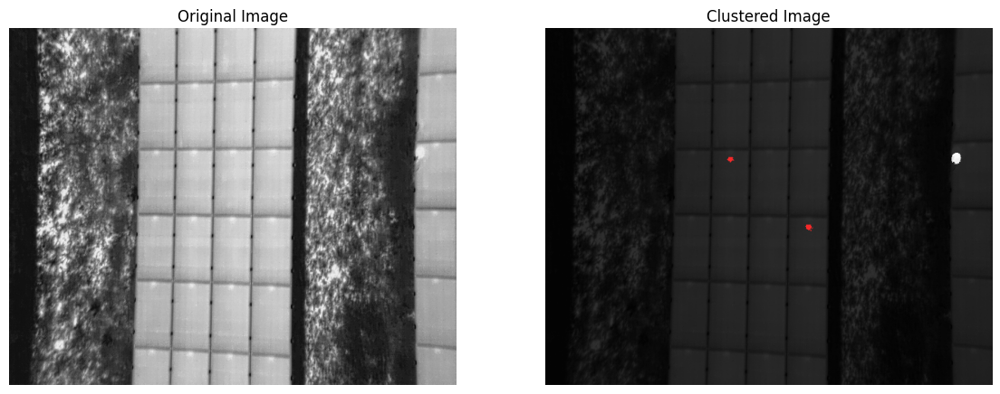

Processing image 048R.jpg


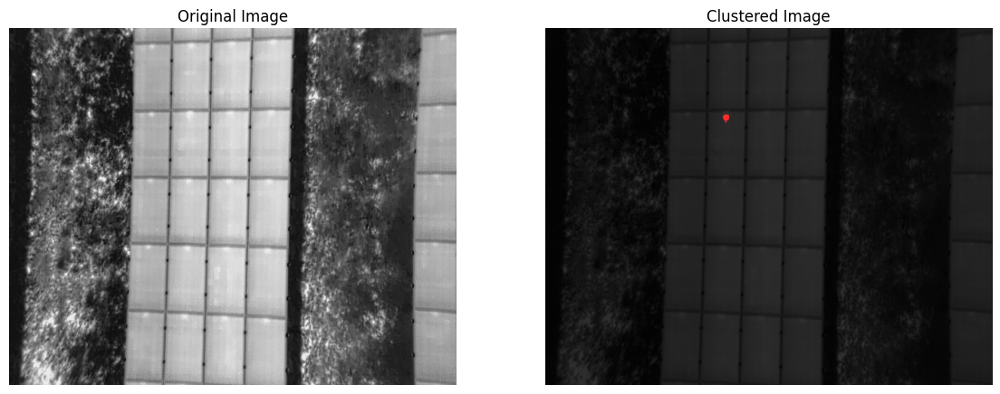

Processing image 042R.jpg


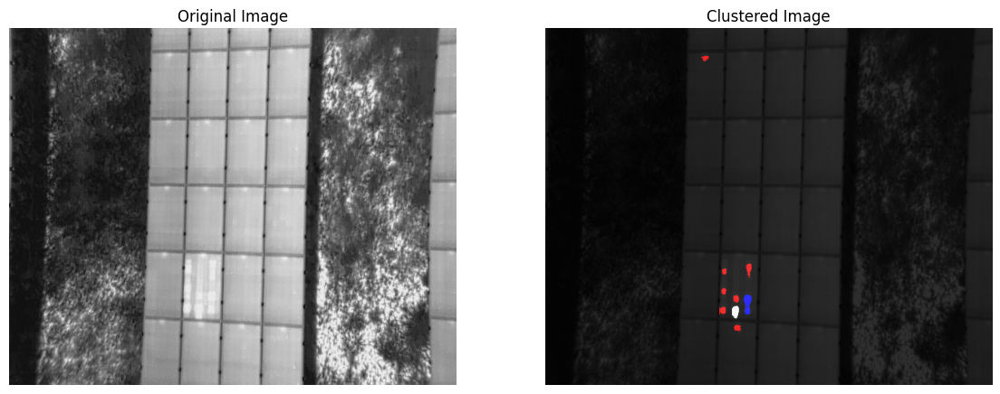

Processing image 049R.jpg


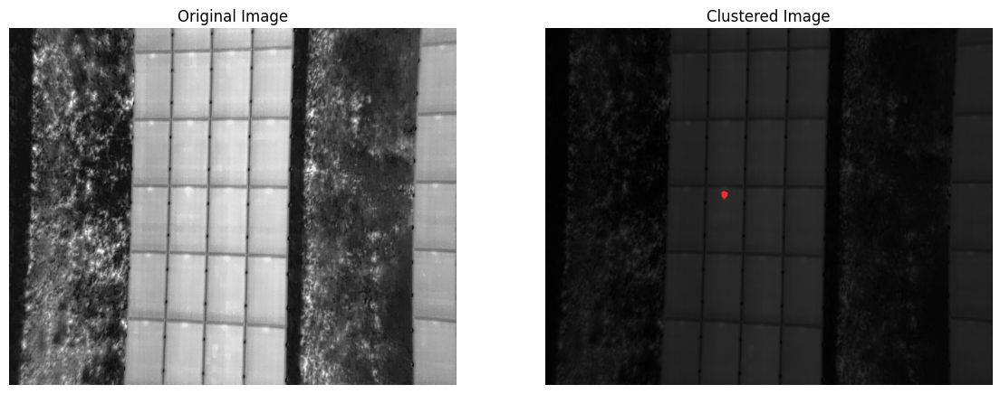

Processing image 082R.jpg


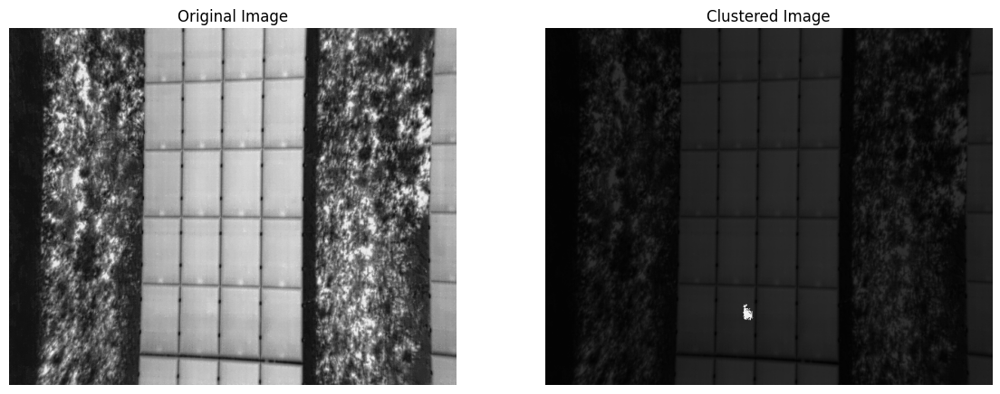

Processing image 034R.jpg


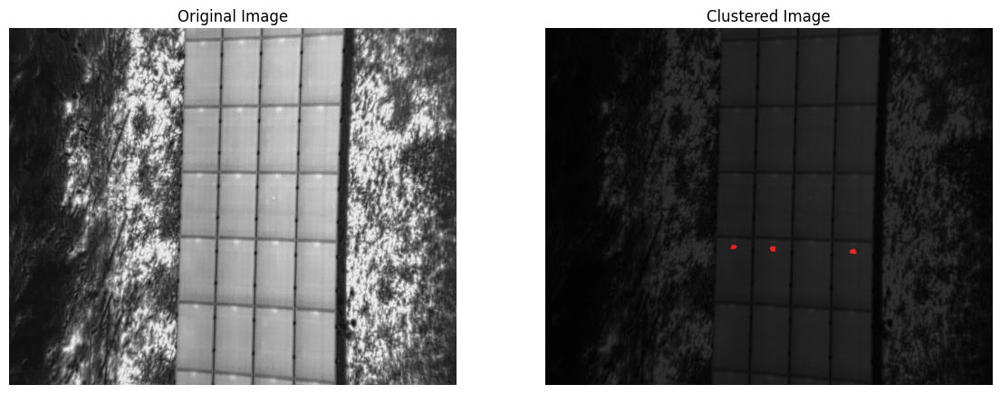

Processing image 039R.jpg


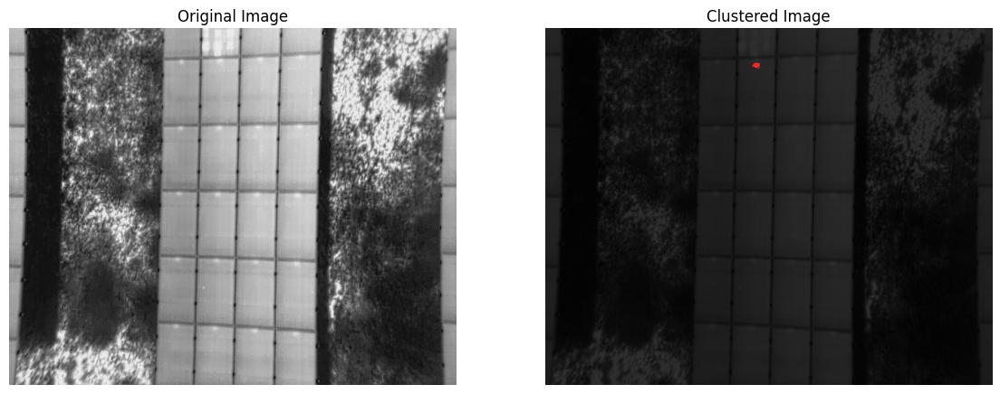

Processing image 064R.jpg


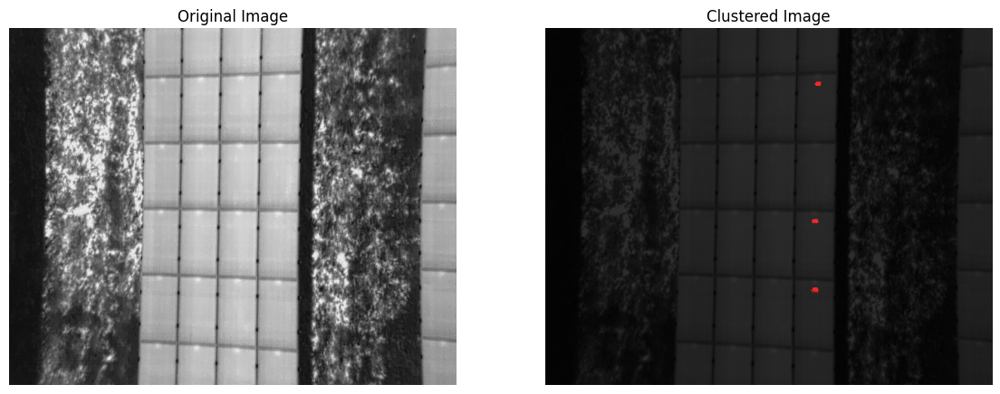

Processing image 045R.jpg


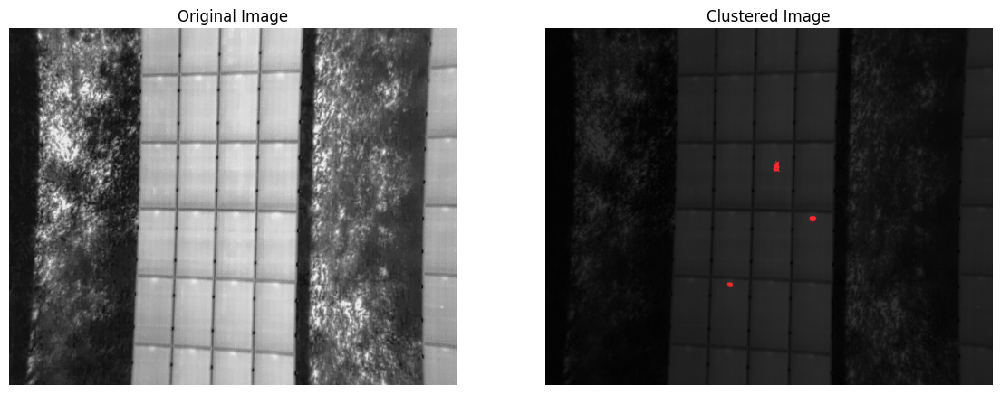

Processing image 068R.jpg


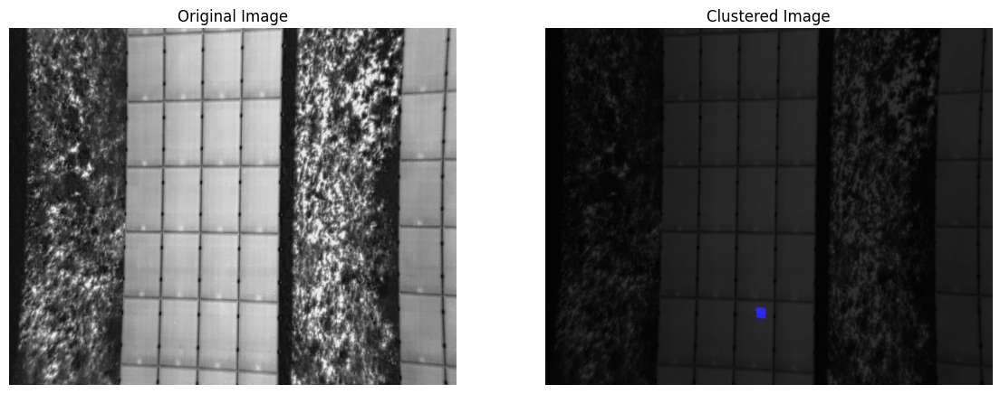

Processing image 036R.jpg


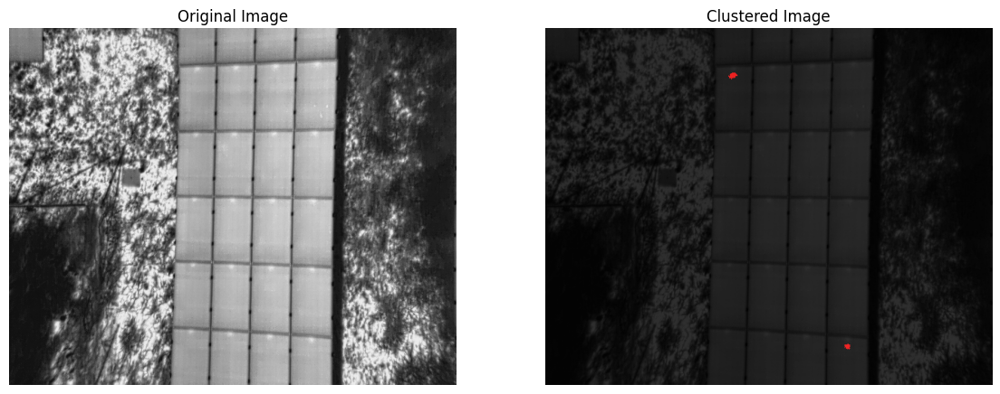

Processing image 010R.jpg


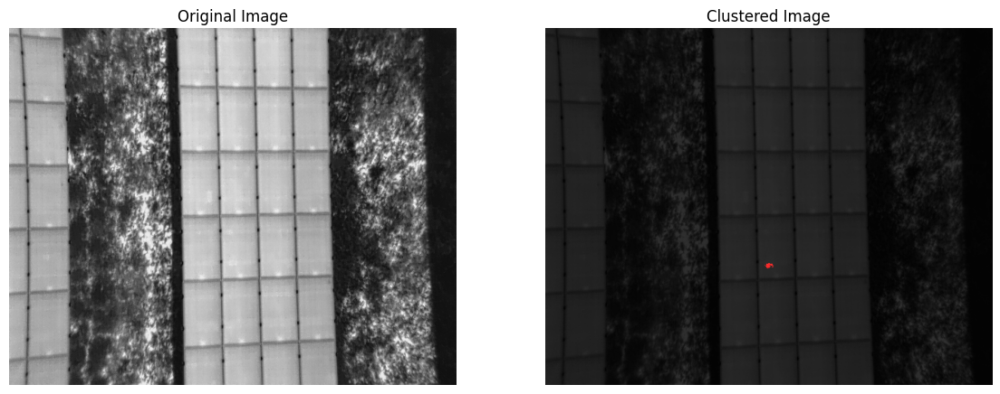

Processing image 044R.jpg


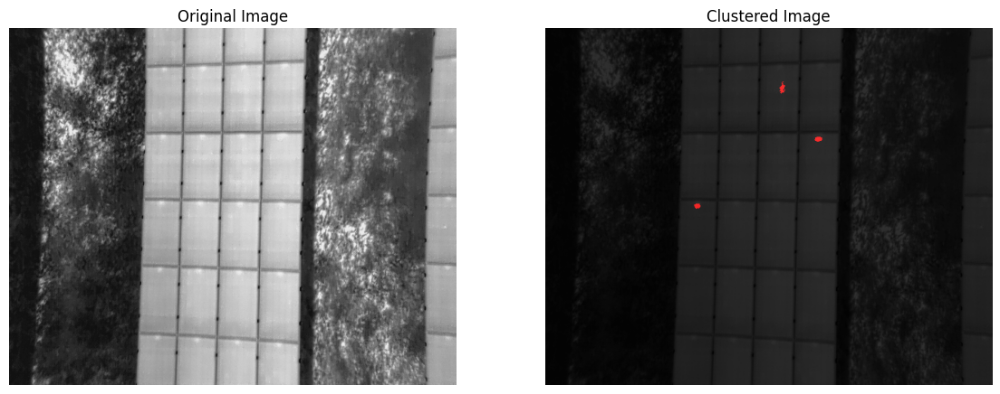

Processing image 061R.jpg


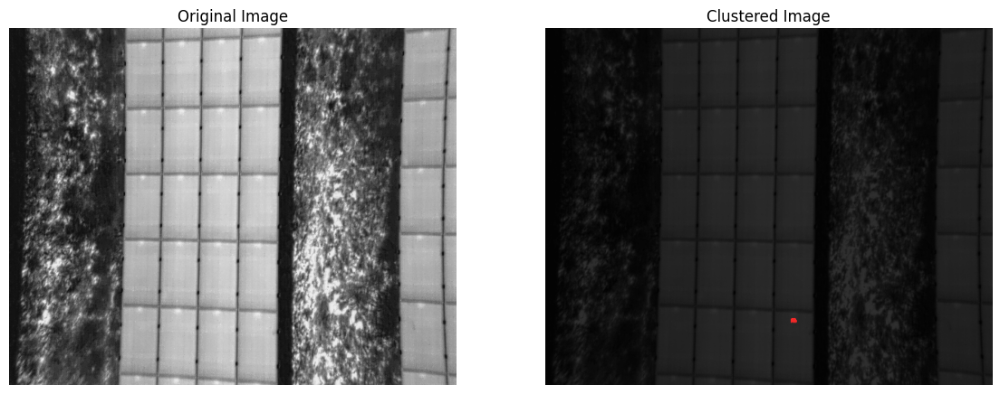

Processing image 047R.jpg


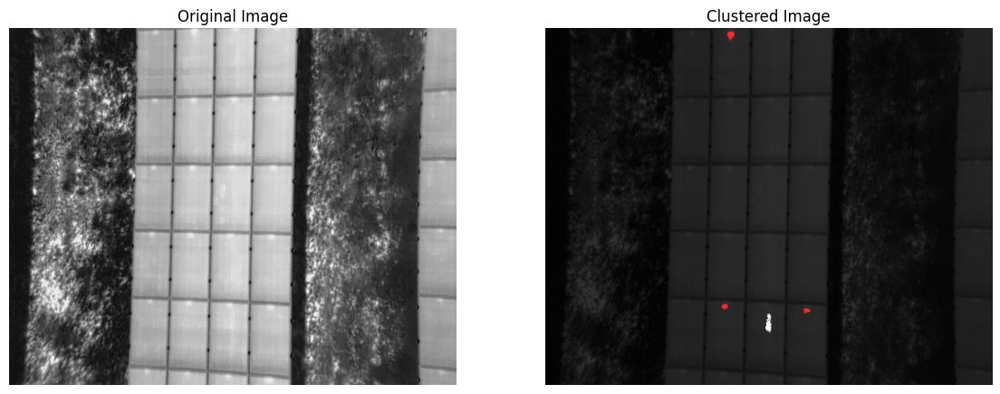

Processing image 081R.jpg


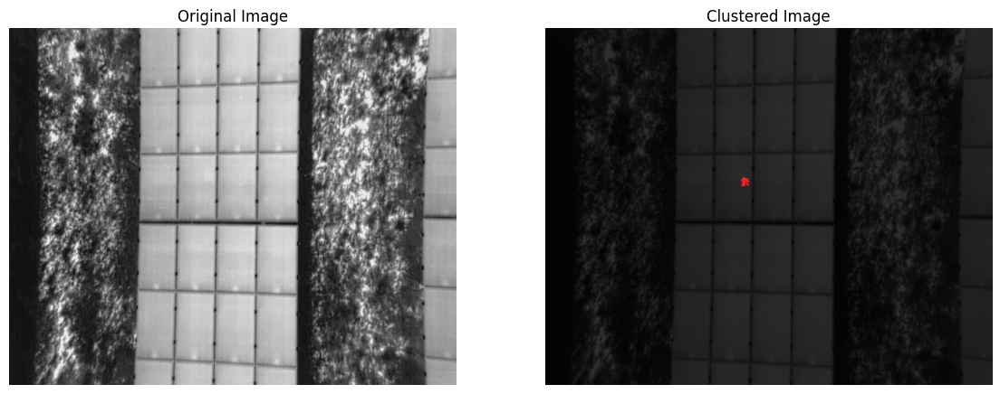

Processing image 120R.jpg


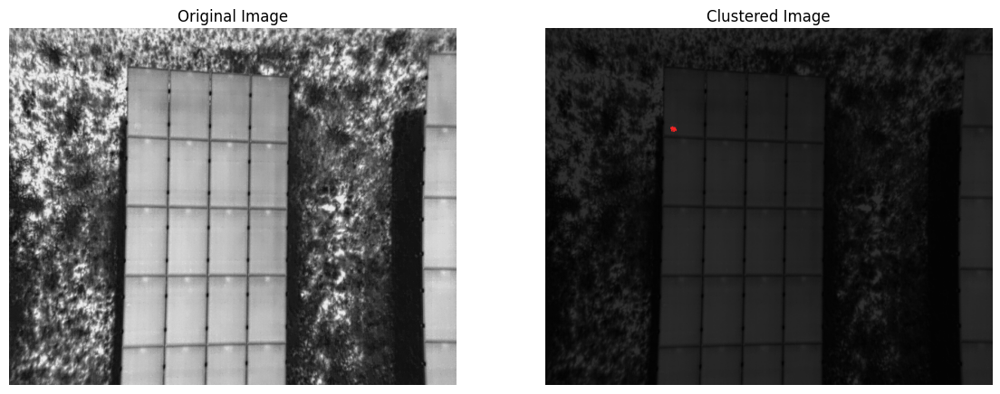

Processing image 067R.jpg


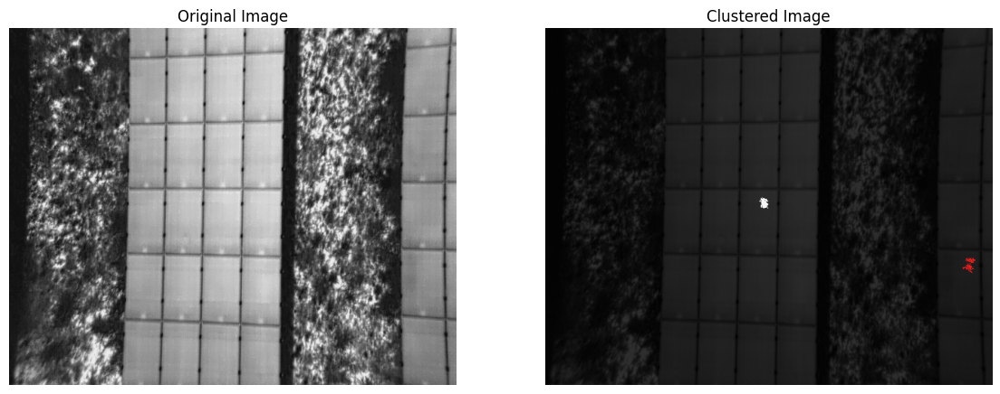

Processing image 041R.jpg


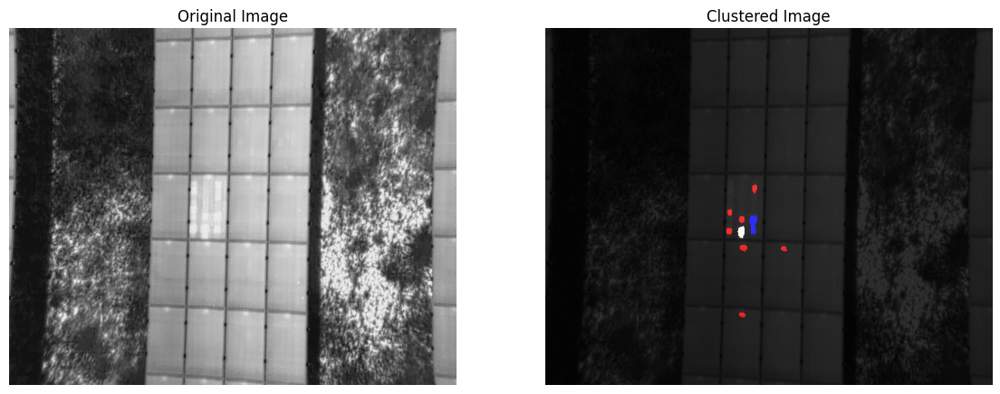

Processing image 060R.jpg


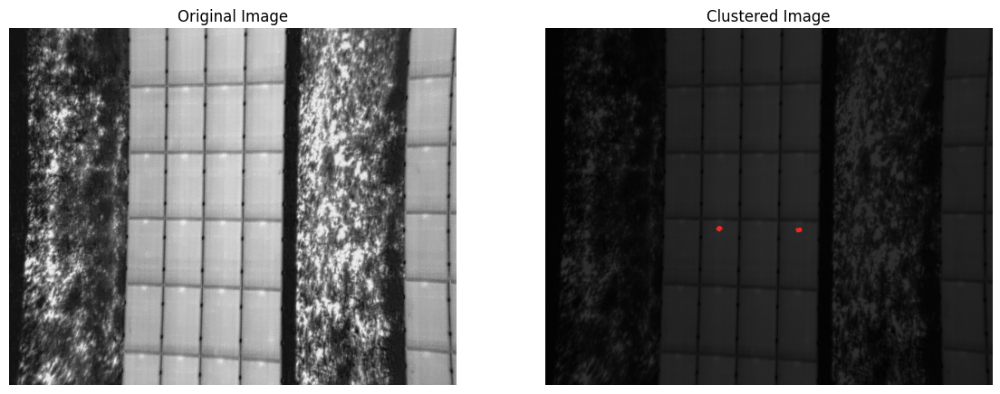

Processing image 008R.jpg


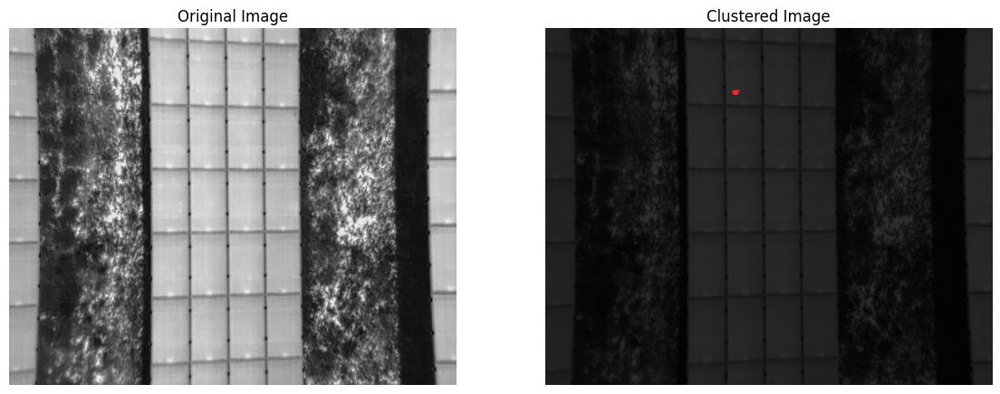

Processing image 080R.jpg


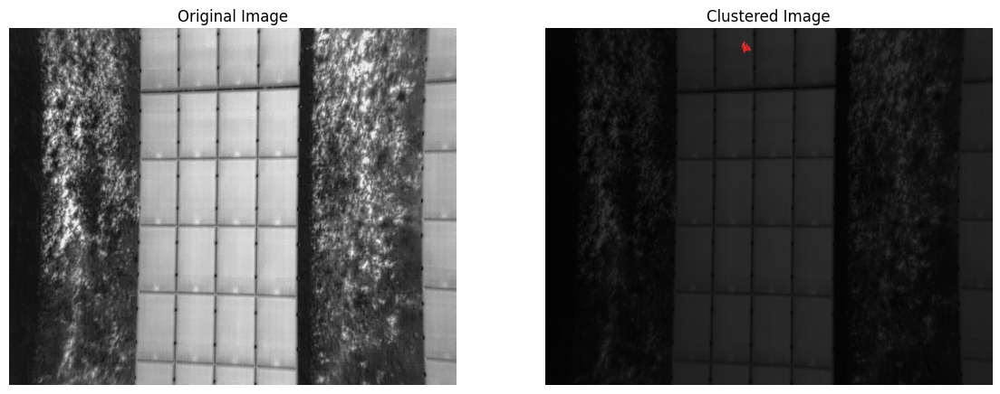

Processing image 037R.jpg


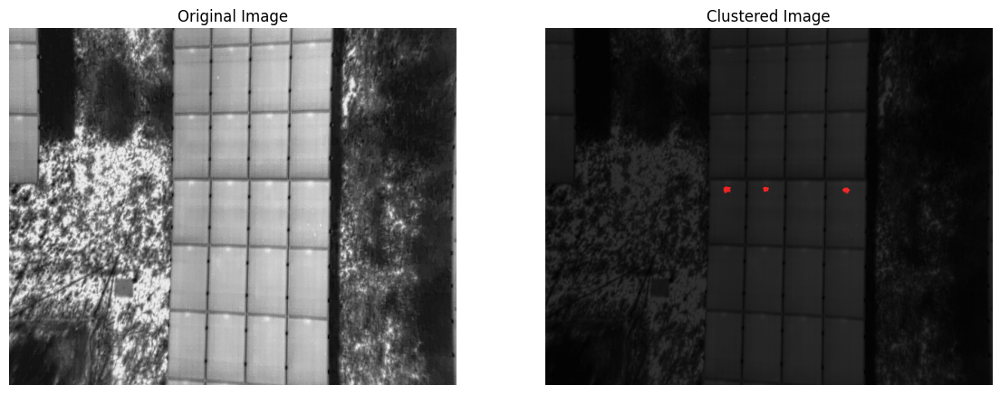

'/content/clustered_images.zip'

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from PIL import Image
import shutil

def create_clustered_image(original_image_path, image_df, output_path):
    """
    Creates an image where each cluster is color-coded based on its pixel coordinates.

    Parameters:
    - merged_df: DataFrame containing cluster information and corresponding pixel coordinates.
    - image_shape: Shape of the original image (height, width).

    Returns:
    - clustered_image: Image with clusters color-coded.
    """

    # Initialize a blank image (RGB, with zeros)
    clustered_image = np.zeros((512, 640, 3), dtype=np.uint8)

    original_image = Image.open(original_image_path).convert("RGB")  # Convert to RGB if not already

    # Here, you can manually specify the colors in RGB format (scaled to 255)
    custom_colors = {
        0: [255, 0, 0],       # Cluster 0 - Red
        3: [255, 255, 255],       # Cluster 1 - White
        1: [0, 0, 255],     # Cluster 3 - Blue
        2: [255, 165, 0],     # Cluster 4 - Orange
        # Add more clusters and their respective colors as needed
    }

    # Loop through each row of the merged DataFrame and color the pixels according to the cluster
    for _, row in image_df.iterrows():
        # print(row)
        # Get the cluster_id and pixel coordinates
        cluster_id = row['Cluster_id']
        pixel_coords = row['absolute_coords']  # Pixel coordinates are already in list form

        # Get the color for this cluster from the custom_colors dictionary
        cluster_color = custom_colors.get(cluster_id, [0, 0, 0])  # Default to black if cluster_id is not found

        # Color the corresponding pixels in the image
        for coord in pixel_coords:
            x, y = coord
            clustered_image[x, y] = cluster_color  # Set the pixel color

    blended_image = np.array(original_image) * 0.2 + clustered_image * 0.8  # Adjust blend ratio as needed
    blended_image = blended_image.astype(np.uint8)

    # Display the original and clustered images side by side
    plt.figure(figsize=(14, 6))

    # Show original image
    plt.subplot(1, 2, 1)
    plt.imshow(original_image)
    plt.title("Original Image")
    plt.axis("off")

    # Show clustered image
    plt.subplot(1, 2, 2)
    plt.imshow(blended_image)
    plt.title("Clustered Image")
    plt.axis("off")

    plt.show()

    # Save the blended image
    output_file_path = os.path.join(output_path, os.path.basename(original_image_path))
    # print(output_file_path)
    Image.fromarray(blended_image).save(output_file_path)

    return blended_image

image_folder = "/content/dataset/dataset_1/images"
output_folder = "/content/clustered_images"  # Folder to save blended images

# Create the output directory if it doesn't exist
os.makedirs(output_folder, exist_ok=True)

for image_name in filtered_features_df['image_name'].unique():
        # Construct the image path
        original_image_path = os.path.join(image_folder, image_name)

        # Load the corresponding thermal image
        if not os.path.exists(original_image_path):
            print(original_image_path)
            print(f"Image {image_name} not found. Skipping.")
            continue
        else :
            print(f"Processing image {image_name}")

        # Filter rows for the current image
        image_df = filtered_features_df[features_df['image_name'] == image_name]

        # Call the function to create the clustered image
        clustered_image = create_clustered_image(original_image_path, image_df, output_folder)

# Zip the output folder for download
shutil.make_archive(output_folder, 'zip', output_folder)
